# <div class="header1"><center>Customer Credit Card Analysis</center></div>
<div class="explain-box" style="text-align: right;">
    <right>
        Created by : Isabel Johnson
    </right>
</div>

# <div class="header1">1. | Introduction </div>
<div class="explain-box">
    Credit card usage behavior data is a valuable resource for companies seeking to optimize their marketing strategies. By understanding the patterns of behavior exhibited by credit card users, companies can tailor their marketing efforts to target specific groups of users more effectively. However, working with such data can present several challenges, including data quality issues, missing values, and the need to identify meaningful patterns within the data. Our goal is to group users based on their behavior in order to develop an effective and efficient credit card marketing strategy.
</div>

## <div class="header1">1.1 | Getting Started </div>
<div class="explain-box">
    Download the Customer_Credit_Card _Analysis.ipynb.Download the Kaggle API token to the current directory.</br></div>

In [1]:
pip install kaggle
pip install opendatasets

Note: you may need to restart the kernel to use updated packages.


In [3]:
import opendatasets as od
import pandas

In [6]:
od.download(
    "https://www.kaggle.com/datasets/arezalo/customer-dataset")

Skipping, found downloaded files in ".\customer-dataset" (use force=True to force download)


# <div class="header1">2. | About the dataset </div>
<div class="explain-box">
    In this project, we will work with a dataset containing the credit card usage behavior of around 9000 users over a six-month period. We will explore the data, preprocess it, and apply clustering algorithms to segment the customers into different groups based on their usage behavior.
</div>

### <div class="header2">2.1 | Dataset Description</div>
<div class="explain-box">
    The following is the <b>structure of the dataset</b>.<br>
    
<table style="font-family: Merriweather; font-weight: 300; font-size: 12px; text-align: left; padding: 8px; border-collapse: collapse; width: 100%;">
  <thead>
    <tr>
      <th style="font-family: Merriweather; font-weight: 900; text-align: center; font-size: 14px">Variable Name</th>
      <th style="font-family: Merriweather; font-weight: 900; text-align: center; font-size: 14px">Description</th>
      <th style="font-family: Merriweather; font-weight: 900; text-align: center; font-size: 14px">Sample Data</th>
    </tr>
  </thead>
  <tbody>
      <tr>
          <td>CUST_ID</td>
          <td>Credit card holder ID</td>
          <td>C10001; C10002; ...</td>
      </tr>
      <tr>
          <td>BALANCE</td>
          <td>Remaining account balance available for purchases</td>
          <td>40.900749; 3202.467416; ...</td>
      </tr>
      <tr>
          <td>BALANCE_FREQUENCY</td>
          <td>Balance update frequency (between 0 and 1)<br><br>1 = frequently updated<br>0 = not frequently updated</td>
          <td>0.818182; 0.909091; ...</td>
      </tr>
      <tr>
          <td>PURCHASES</td>
          <td>Account purchases amount</td>
          <td>95.4; 773.17; ...</td>
      </tr>
      <tr>
          <td>ONEOFF_PURCHASES</td>
          <td>Maximum purchase amount in single transaction</td>
          <td>1499; 16; ...</td>
      </tr>
      <tr>
          <td>INSTALLMENTS_PURCHASES</td>
          <td>Amount purchase in installment</td>
          <td>95.4; 1333.28; ...</td>
      </tr>
      <tr>
          <td>CASH_ADVANCE</td>
          <td>The user's advance payment in cash</td>
          <td>6442.945483; 205.788017; ...</td>
      </tr>
      <tr>
          <td>PURCHASES_FREQUENCY</td>
          <td>Frequency of purchases made on a regular basis (between 0 and 1)<br><br>1 = frequently purchased<br>0 = not frequently purchased</td>
          <td>0.166667; 0.083333; ...</td>
      </tr>
      <tr>
          <td>ONEOFF_PURCHASES_FREQUENCY</td>
          <td>Frequency of purchases made in single transaction (between 0 and 1)<br><br>1 = frequently purchased<br>0 = not frequently purchased</td>
          <td>0.083333; 0.083333; ...</td>
      </tr>
      <tr>
          <td>PURCHASES_INSTALLMENTS_FREQUENCY</td>
          <td>Frequency of done purchases in installments (between 0 and 1)<br><br>1 = frequently done<br>0 = not frequently done</td>
          <td>0.083333; 0.583333; ...</td>
      </tr>
      <tr>
          <td>CASH_ADVANCE_FREQUENCY</td>
          <td>Frequency of cash in advance</td>
          <td>0.25; 0.083333; ...</td>
      </tr>
      <tr>
          <td>CASH_ADVANCE_TRX</td>
          <td>"Cash in advance" total transactions</td>
          <td>0; 4; ...</td>
      </tr>
      <tr>
          <td>PURCHASES_TRX</td>
          <td>Purchase total transactions</td>
          <td>2; 12; ...</td>
      </tr>
      <tr>
          <td>CREDIT_LIMIT</td>
          <td>Credit card limit of an user</td>
          <td>1000; 7000; ...</td>
      </tr>
      <tr>
          <td>PAYMENTS</td>
          <td>Total amount paid by the user</td>
          <td>201.802084; 4103.032597; ...</td>
      </tr>
      <tr>
          <td>MINIMUM_PAYMENTS</td>
          <td>Minimum payment amount made by user</td>
          <td>139.509787; 1072.340217; ...</td>
      </tr>
      <tr>
          <td>PRC_FULL_PAYMENT</td>
          <td>Percent of total charge paid by the user</td>
          <td>0; 0.222222; ...</td>
      </tr>
      <tr>
          <td>TENURE</td>
          <td>Credit card tenure of an user</td>
          <td>12; 8; ...</td>
      </tr>
  </tbody>
</table>
    
<hr>
</div>

# <div class="header1">3. | Objectives</div>
<div class="explain-box">
    This notebook aims to:
    <ul>
        <li>Perform dataset exploration using various types of data visualization.</li>
        <li>Perform data preprocessing before using models.</li>
        <li>Grouping customers into clusters using various clustering models.</li>
        <li>Perform interpretation and analysis of the groups (profiling) that have been created.</li>
        <li>Provide marketing suggestions based on profiling results and analysis conducted.</li>
    </ul>
</div>

### <div class="header2">3.1 | Clustering Models</div>
<div class="explain-box">
    The <b>clustering models</b> used in this notebook are:
    <ol>
        <li><b>Partition based (K-Means)</b>,</li>
        <li><b>Density based (DBSCAN)</b>, and</li>
        <li><b>Hierarchical Clustering (Agglomerative)</b>.</li>
    </ol>
</div>

# <div class="header1">4. | Data Exploration</div>

### <div class="header2">4.1 | Installing and importing libraries</div>

In [51]:
!pip install yellowbrick
!pip install pywaffle

In [7]:
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import numpy as np
import yellowbrick
import seaborn as sns
import warnings
import os
import scipy.cluster.hierarchy as shc
import matplotlib.patches as patches
from matplotlib.patches import Rectangle
from pywaffle import Waffle
from math import isnan
from math import isnan
from random import sample
from numpy.random import uniform
from sklearn.neighbors import NearestNeighbors
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.metrics import davies_bouldin_score, silhouette_score, calinski_harabasz_score
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from yellowbrick.style import set_palette
from yellowbrick.contrib.wrapper import wrap

import warnings
warnings.filterwarnings('ignore')

### <div class="header1">4.2 | Reading Dataset</div>

In [8]:
# --- Importing Dataset ---
df = pd.read_csv(r'customer-dataset\Customer_Data.csv')
# --- Reading Train Dataset ---
df.head()

,cust_id,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


### <div class="header2">4.3 | Initial Dataset Exploration</div>

In [3]:
ProfileReport(df, title="Pandas Profiling Report")


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### <div class="header2">Observations:-</div>
<div class="explain-box">
    <blockquote style="color: #000000;">
        <ul>
            <li>There are <mark><b>missing values</b></mark> in <b>CREDIT_LIMIT</b> (<b>1</b> missing value) and <b>MINIMUM_PAYMENTS</b> (<b>313</b> missing values).</li>
            <li><mark><b>Most columns have a massive number of 0 values</b></mark>. Moreover, <mark><b>most columns are highly right-skewed</b></mark>, as seen from the histograms and the comparison of mean and median values (the mean value are smaller than the median value).</li>
            <li><mark><b>Some variables have moderate to high correlation values</b></mark> to other variables (>0.5 to 1). Examples of high correlation variables are <b>PURCHASES and ONEOFF_PURCHASES</b>, with a <b>0.92</b> correlation value. Another example is <b>CASH_ADVANCE_TRX with CASH_ADVANCE_FREQUENCY</b> with a <b>0.8</b> correlation value.</li>
            <li>When using a credit card, <b>most credit card customers prefer 12 months tenure</b> compared to other tenure options. This can be concluded that <mark><b>customers are more likely to repay credits in the long term with the consequence of a higher interest rate</b></mark>.</li>
            <li>When investigating the <b>BALANCE</b> column further, it seems that <b>there are many credit cards with 0 balances</b>. It is also supported with <b>so many 0 purchase amounts in PURCHASE column</b>. Based on those results, it can be assumed that <mark><b>some users are intentionally keeping the balance low in their account in order to get high credit limit</b></mark>, which affects to <mark><b>increase credit utilization ratio and the credit score</b></mark>.<br>
            <li>Most of credit card accounts have <b>1 score</b> in <b>BALANCE_FREQUENCY</b> column, which indicates that <mark><b>most customers use credit card frequently</b></mark>. However, this is <b>different from ONEOFF_PURCHASES and PURCHASES_INSTALLMENT_FREQUENCY</b>, where the <mark><b>majority of customers do not use credit cards for one-time transactions or payments in installments</b></mark>.</li>
        </ul>
    </blockquote>
</div>

### <div class="header2">4.4 | EDA</div>

### <div class="header2">4.4.1 |  Credit Limit vs. Balance based on Tenure</div>

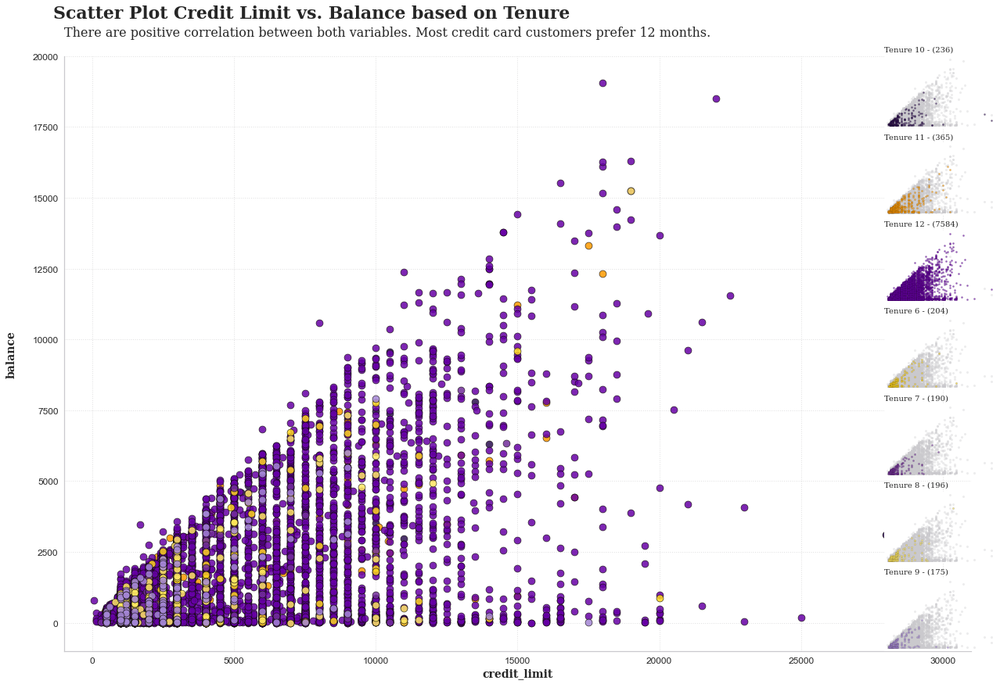

In [66]:
import matplotlib.pyplot as plt

# --- EDA 1 Variables ---
scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.85)
sub_scatter_style_color=dict(s=5, alpha=0.65, linewidth=0.15, zorder=10, edgecolor='#100C07')
sub_scatter_style_grey=dict(s=5, alpha=0.3, linewidth=0.7, zorder=5, color='#CAC9CD')
grid_style=dict(alpha=0.3, color='#9B9A9C', linestyle='dotted', zorder=1)
xy_label=dict(fontweight='bold', fontsize=14, fontfamily='serif')
suptitle=dict(fontsize=22, fontweight='heavy', fontfamily='serif')
title=dict(fontsize=16, fontfamily='serif')
color_pallete=['#2D0F51', '#FF9A00', '#6600A5', '#FFD61E', '#722E9A', '#FFE863', '#A486D5']
sub_axes=[None] * 7

# --- EDA 1 Data Frame ---
eda1 = df[['credit_limit', 'balance', 'tenure']]
eda1['tenure'] = eda1['tenure'].astype(str)
tenure = sorted(eda1['tenure'].unique())

# --- EDA 1 Settings ---
fig = plt.figure(figsize=(22, 14))
gs = fig.add_gridspec(7, 7)
ax = fig.add_subplot(gs[:, :7])
ax.set_aspect(1)

# --- EDA 1: Main Scatter Plot ---
for x in range(len(tenure)):
    eda1_x = eda1[eda1['tenure']==tenure[x]]
    ax.scatter(eda1_x['credit_limit'], eda1_x['balance'], s=80, color=color_pallete[x], **scatter_style)
    ax.set_title('There are positive correlation between both variables. Most credit card customers prefer 12 months.\n', loc='left', **title)
    ax.set_xlabel('credit_limit', **xy_label)
    ax.set_ylabel('balance\n', **xy_label)
    ax.grid(axis='y', which='major', **grid_style)
    ax.grid(axis='x', which='major', **grid_style)
    for spine in ax.spines.values():
        spine.set_color('None')
    for spine in ['bottom', 'left']:
        ax.spines[spine].set_visible(True)
        ax.spines[spine].set_color('#CAC9CD')
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

# --- EDA 1: Sub Plots ---
for idx, tnr in enumerate(tenure):
    sub_axes[idx] = fig.add_subplot(gs[idx, 6], aspect=1)
    
    sub_axes[idx].scatter(eda1[eda1['tenure']!=tnr]['credit_limit'], eda1[eda1['tenure']!=tnr]['balance'], label=tnr, **sub_scatter_style_grey)
    sub_axes[idx].scatter(eda1[eda1['tenure']==tnr]['credit_limit'], eda1[eda1['tenure']==tnr]['balance'], color=color_pallete[idx], label=tnr, **sub_scatter_style_color)
    
    cnt = (eda1['tenure']==tnr).sum()
    sub_axes[idx].set_title(f'Tenure {tnr} - ({cnt})', loc='left', fontsize=10, fontfamily='serif')
    sub_axes[idx].set_xticks([])
    sub_axes[idx].set_yticks([])
    for spine in sub_axes[idx].spines.values():
        spine.set_color('None')

# --- EDA 1 XY Limit ---
for axes in [ax] + sub_axes:
    axes.set_xlim(-1000, 31000)
    axes.set_ylim(-1000, 20000)

# --- EDA 1 Title ---
plt.suptitle('Scatter Plot Credit Limit vs. Balance based on Tenure', x=0.138, y=0.945, ha='left', **suptitle)
plt.show();


### <div class="header2">Observations:-</div>
<div class="explain-box">
    The scatter plot shows that <b>when the variable values increase, the distribution/residual variance also increases</b> until it forms a cone shape (<mark><b>heteroscedasticity</b></mark>). Also, as previously mentioned, <b>most credit card customers prefer 12 months tenure</b>.
</div>

### <div class="header2">4.4.2 |  Purchases Amount vs. Total Transaction</div>

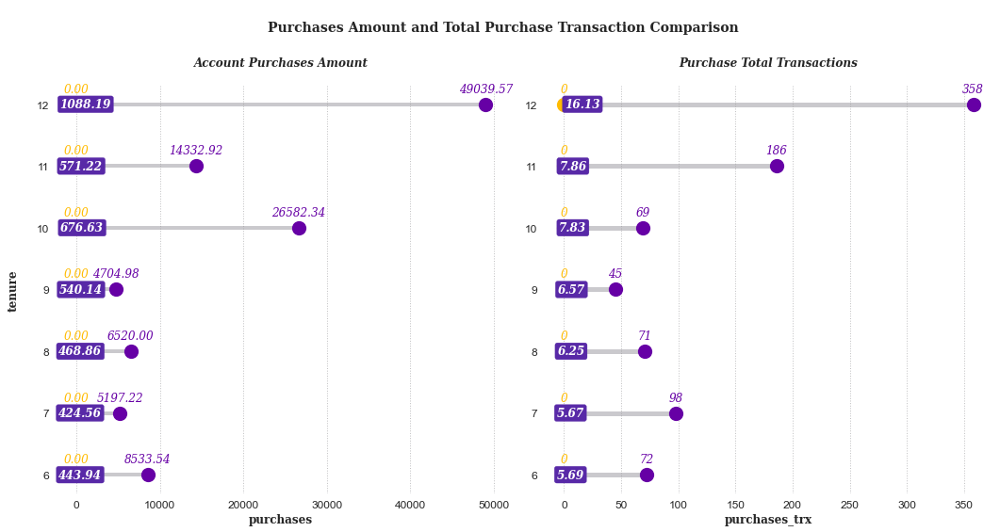

In [67]:
# --- EDA 2 Variables ---
title=dict(fontsize=12, fontfamily='serif', style='italic', weight='bold', ha='center')
grid_style = dict(alpha=0.6, color='#9B9A9C', linestyle='dotted', zorder=1)
sct_style = dict(s=175, linewidth=2)
xy_label = dict(fontweight='bold', fontsize=12, fontfamily='serif')
ann_style = dict(xytext=(0, 0), textcoords='offset points', va='center', ha='center', style='italic', fontfamily='serif')
tenure = sorted(df['tenure'].unique())
color_pallete = ['#2D0F51', '#FF9A00', '#6600A5', '#FFD61E', '#722E9A', '#FFE863', '#A486D5']

# --- EDA 2.1 Data Frame ---
eda2_1 = df[['purchases', 'tenure']]
eda2_1 = eda2_1.groupby('tenure').agg(MIN=('purchases', 'min'), AVG=('purchases', 'mean'), MAX=('purchases', 'max')).reset_index()

# --- EDA 2.2 Data Frame ---
eda2_2 = df[['purchases_trx', 'tenure']]
eda2_2 = eda2_2.groupby('tenure').agg(MIN=('purchases_trx', 'min'), AVG=('purchases_trx', 'mean'), MAX=('purchases_trx', 'max')).reset_index()

# --- EDA 2.1 & 2.2 Settings ---
fig = plt.figure(figsize=(15, 8))
plt.suptitle('\nPurchases Amount and Total Purchase Transaction Comparison', fontweight='heavy', fontsize=14, fontfamily='serif')

# --- EDA 2.1 (Left Dumbbell) ---
plt.subplot(1, 2, 1)
plt.tight_layout(rect=[0, 0, 1, 1.01])
axs_left=plt.gca()
min_sct = plt.scatter(x=eda2_1['MIN'], y=eda2_1['tenure'], c='#FFBB00', **sct_style)
max_sct = plt.scatter(x=eda2_1['MAX'], y=eda2_1['tenure'], c='#6600A5', **sct_style)
for i in range(len(tenure)):
    eda2_1_x = eda2_1[eda2_1['tenure']==tenure[i]]
    plt.hlines(y=eda2_1_x['tenure'], xmin=eda2_1_x['MIN'], xmax=eda2_1_x['MAX'], linewidth=4, color='#CAC9CD', zorder=0)
    plt.annotate('{0:.2f}'.format(eda2_1_x['MIN'].values[0]), xy=(eda2_1_x['MIN'].values[0], eda2_1_x['tenure'].values[0]+0.25), color='#FFBB00', fontsize=12, **ann_style)
    plt.annotate('{0:.2f}'.format(eda2_1_x['AVG'].values[0]), xy=(eda2_1_x['AVG'].values[0], eda2_1_x['tenure'].values[0]), color='w', fontsize=12, fontweight='bold', bbox=dict(boxstyle='round', pad=0.2, color='#5829A7'), **ann_style)
    plt.annotate('{0:.2f}'.format(eda2_1_x['MAX'].values[0]), xy=(eda2_1_x['MAX'].values[0], eda2_1_x['tenure'].values[0]+0.25), color='#6600A5', fontsize=12, **ann_style)
for spine in axs_left.spines.values():
    spine.set_color('None')
plt.xlabel('purchases', **xy_label)
plt.ylabel('tenure\n', **xy_label)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', alpha=0)
plt.grid(axis='x', which='major', **grid_style)
plt.title('\nAccount Purchases Amount\n', **title)

# --- EDA 2.2 (Right Dumbbell) ---
plt.subplot(1, 2, 2)
plt.tight_layout(rect=[0, 0, 1, 1.01])
axs_right=plt.gca()
min_sctt = plt.scatter(x=eda2_2['MIN'], y=eda2_2['tenure'], c='#FFBB00', **sct_style)
max_sctt = plt.scatter(x=eda2_2['MAX'], y=eda2_2['tenure'], c='#6600A5', **sct_style)
for i in range(len(tenure)):
    eda2_2_x = eda2_2[eda2_2['tenure']==tenure[i]]
    plt.hlines(y=eda2_2_x['tenure'], xmin=eda2_2_x['MIN'], xmax=eda2_2_x['MAX'], linewidth=5, color='#CAC9CD', zorder=0)
    plt.annotate('{:.0f}'.format(eda2_2_x['MIN'].values[0]), xy=(eda2_2_x['MIN'].values[0], eda2_2_x['tenure'].values[0]+0.25), color='#FFBB00', fontsize=12, **ann_style)
    plt.annotate('{0:.2f}'.format(eda2_2_x['AVG'].values[0]), xy=(eda2_2_x['AVG'].values[0], eda2_2_x['tenure'].values[0]), color='w', fontsize=12, fontweight='bold', bbox=dict(boxstyle='round', pad=0.2, color='#5829A7'), **ann_style)
    plt.annotate('{:.0f}'.format(eda2_2_x['MAX'].values[0]), xy=(eda2_2_x['MAX'].values[0], eda2_2_x['tenure'].values[0]+0.25), color='#6600A5', fontsize=12, **ann_style)
for spine in axs_right.spines.values():
    spine.set_color('None')
plt.xlabel('purchases_trx', **xy_label)
plt.ylabel('')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', alpha=0)
plt.grid(axis='x', which='major', **grid_style)
plt.title('\nPurchase Total Transactions\n', **title)
plt.show();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    From the dumbbell chart above, it can be concluded that <mark><b>credit card customers with 12 months of tenure are willing to take the purchase amount and have more total purchase transactions than customers with other tenure periods</b></mark>. This is related to the previous topic, where <b>customers are more likely to repay debts over a long period, in order to increasing the interest rate</b>. Moreover, <mark><b>some customers deliberately do not make any transactions at all</b></mark> (0 purchases and transactions) to <b>get a high credit limit</b>, which impacts <b>increasing credit scores and credit use ratios</b>.<br><br>
    The graph above also shows that customers with <b>ten months of tenure have a higher purchase amount than customers with 11 months of tenure</b>. However, this is inversely proportional to total transactions, where <b>ten months-tenure customers have fewer transactions than 11 months-tenure customers</b>. Another example is that a <b>customer with a seven month-tenure has a lower purchase amount than a customer with an 8-month tenure</b>. In contrast, <b>the total transactions for seven months-tenure customers are higher than those for eight months-tenure customers</b>.
</div>

### <div class="header2">4.4.3 |  Credit Limit vs. Installment Purchases</div>

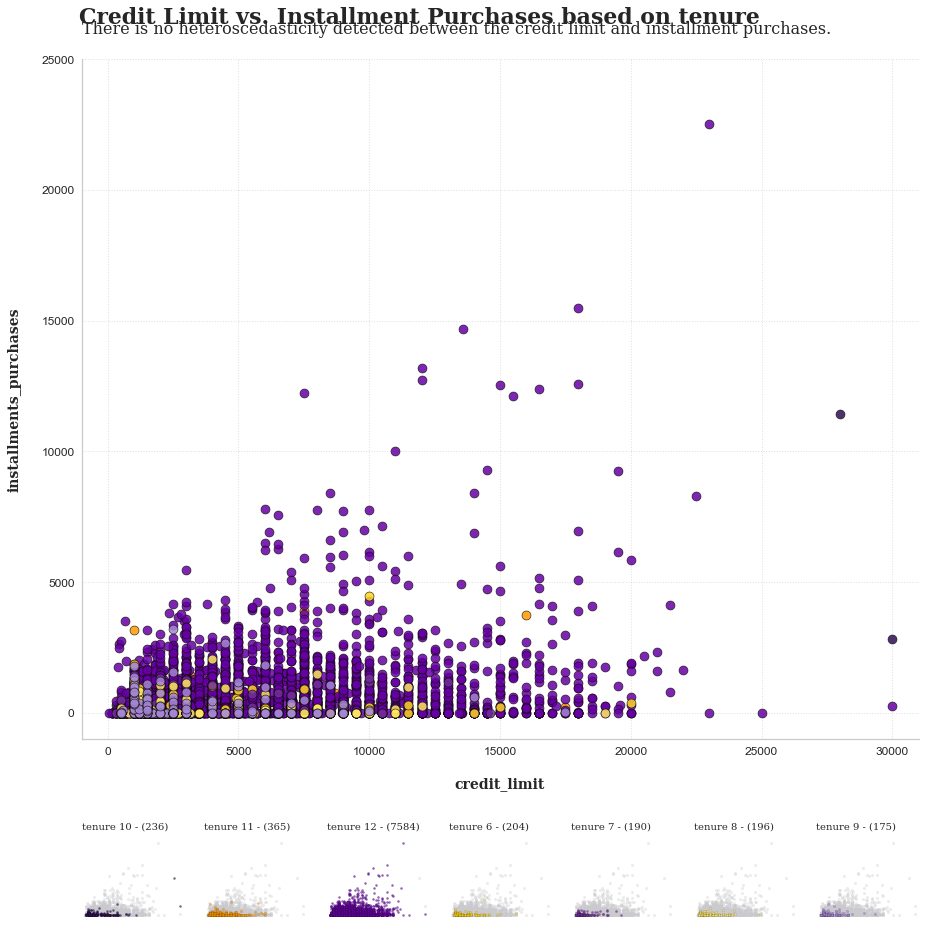

In [68]:
# --- EDA 3 Variables ---
scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.85)
sub_scatter_style_color=dict(s=5, alpha=0.65, linewidth=0.15, zorder=10, edgecolor='#100C07')
sub_scatter_style_grey=dict(s=5, alpha=0.3, linewidth=0.7, zorder=5, color='#CAC9CD')
grid_style=dict(alpha=0.3, color='#9B9A9C', linestyle='dotted', zorder=1)
xy_label=dict(fontweight='bold', fontsize=14, fontfamily='serif')
suptitle=dict(fontsize=22, fontweight='heavy', fontfamily='serif')
title=dict(fontsize=16, fontfamily='serif')
color_pallete=['#2D0F51', '#FF9A00', '#6600A5', '#FFD61E', '#722E9A', '#FFE863', '#A486D5']
sub_axes=[None] * 7

# --- EDA 3 Data Frame ---
eda3 = df[['credit_limit', 'installments_purchases', 'tenure']]
eda3['tenure'] = eda1['tenure'].astype(str)
tenure = sorted(eda1['tenure'].unique())

# --- EDA 3 Settings ---
fig = plt.figure(figsize=(15, 20))
gs = fig.add_gridspec(7, 7)
ax = fig.add_subplot(gs[:7, :])
ax.set_aspect(1)

# --- EDA 3: Main Scatter Plot ---
for x in range(len(tenure)):
    eda3_x = eda3[eda3['tenure']==tenure[x]]
    ax.scatter(eda3_x['credit_limit'], eda3_x['installments_purchases'], s=80, color=color_pallete[x], **scatter_style)
    ax.set_title('There is no heteroscedasticity detected between the credit limit and installment purchases.\n', loc='left', **title)
    ax.set_xlabel('\ncredit_limit', **xy_label)
    ax.set_ylabel('installments_purchases\n', **xy_label)
    ax.grid(axis='y', which='major', **grid_style)
    ax.grid(axis='x', which='major', **grid_style)
    for spine in ax.spines.values():
        spine.set_color('None')
    for spine in ['bottom', 'left']:
        ax.spines[spine].set_visible(True)
        ax.spines[spine].set_color('#CAC9CD')
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

# --- EDA 3: Sub Plots ---
for idx, tnr in enumerate(tenure):
    sub_axes[idx] = fig.add_subplot(gs[6, idx], aspect=1)
    
    sub_axes[idx].scatter(eda3[eda3['tenure']!=tnr]['credit_limit'], eda3[eda3['tenure']!=tnr]['installments_purchases'], label=tnr, **sub_scatter_style_grey)
    sub_axes[idx].scatter(eda3[eda3['tenure']==tnr]['credit_limit'], eda3[eda3['tenure']==tnr]['installments_purchases'], color=color_pallete[idx], label=tnr, **sub_scatter_style_color)
    
    cnt = (eda3['tenure']==tnr).sum()
    sub_axes[idx].set_title(f'tenure {tnr} - ({cnt})', loc='left', fontsize=10, fontfamily='serif')
    sub_axes[idx].set_xticks([])
    sub_axes[idx].set_yticks([])
    for spine in sub_axes[idx].spines.values():
        spine.set_color('None')

# --- EDA 3 XY Limit ---
for axes in [ax] + sub_axes:
    axes.set_xlim(-1000, 31000)
    axes.set_ylim(-1000, 25000)

# --- EDA 3 Title ---
plt.suptitle('Credit Limit vs. Installment Purchases based on tenure', x=0.123, y=0.775, ha='left', **suptitle)
plt.show();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    The scatter plot shows <mark><b>no correlation between both variables</b></mark> since the scatter plot shows a <b>random pattern</b>.
</div>

### <div class="header1">4.3 | Preprocessing</div>


### <div class="header2">4.3.1 | Dropping Variables</div>
<div class="explain-box">
    The first stage is to <mark><b>remove variables that are not needed</b></mark> for the clustering process. In this case, <b>CUST_ID will be removed</b> since it has unique values.
</div>

In [69]:
# --- Dropping `cust_id` Column ---
df = df.drop(['cust_id'], axis=1)

# --- Showing Dataframe ---
print(' Dataframe after Dropping Variables :.')
df.head()

 Dataframe after Dropping Variables :.


,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


### <div class="header2">4.3.2 | Imputation </div>
<div class="explain-box">
    Since the dataset is about clustering, imputation will use <code>KNNImputer()</code> to <mark><b>avoid biased clustering results</b></mark>. The <b>mean value from the nearest</b> <code>n_neighbors</code> found in the dataset is used to impute the missing values for each sample.
</div>

In [70]:

from sklearn.neighbors import NearestNeighbors
from sklearn.impute import KNNImputer
# --- List Null Columns ---
null_columns = df.columns[df.isnull().any()].tolist()

# --- Perform Imputation ---
imputer = KNNImputer()
df_imp = pd.DataFrame(imputer.fit_transform(df[null_columns]), columns=null_columns)
df = df.fillna(df_imp)

# --- Showing Dataframe ---
print(' Dataframe after Imputation ')
df.head()

 Dataframe after Imputation 


,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,1215.951453,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


### <div class="header2">4.3.3 | Scaling</div>
<div class="explain-box">
    The next step is <mark><b>scaling</b></mark> the dataset. Scaling is essential since it manages the <b>dataset's variability</b>, <b>transforms data into a defined range</b> using a linear transformation to produce high-quality clusters, and <b>boosts the precision of clustering algorithms</b>. In this case, a <mark><b>standard scaler</b></mark> used to <b>standardizes the feature by removing the mean and scaling to unit variance</b>.
</div>

In [71]:
# --- Scaling Dataset w/ Standard Scaler ---

from sklearn.preprocessing import StandardScaler
X = pd.DataFrame(StandardScaler().fit_transform(df))

### <div class="header2">4.3.4 | Hopkins Test</div>
<div class="explain-box">
    The next step is to perform a statistical test using the <mark><b>Hopkins statistical test</b></mark> for the preprocessed dataset <b>to measure the clustering tendency of data</b> (measure to what degree clusters exist in the data to be clustered).<br><br>The following is the <b>hypothesis of the Hopkins statistical test</b>.
    <blockquote style="color: #000000;">
      <ul>
          <li><b>H<sub>0</sub></b>: The dataset is <mark><b>not uniformly distributed</b></mark> (contains meaningful clusters).</li>
          <li><b>H<sub>1</sub></b>: The dataset is <mark><b>uniformly distributed</b></mark> (no meaningful clusters).</li>
      </ul>
    </blockquote>
    <b>Criteria:</b>
    <blockquote style="color: #000000;">
      <ul>
          <li>If the value is <b>between {0.7, ..., 0.99}</b>, <mark><b>accept H<sub>0</sub></b></mark> (it has a high tendency to cluster).</li>
      </ul>
    </blockquote>
</div>

In [72]:
# --- Hopkins Test (codes by Matevž Kunaver) ---
def hopkins(X):
    d = X.shape[1]
    n = len(X)
    m = int(0.1 * n)
    nbrs = NearestNeighbors(n_neighbors=1).fit(X)
 
    rand_X = sample(range(0, n, 1), m)
 
    ujd = []
    wjd = []
    for j in range(0, m):
        u_dist, _ = nbrs.kneighbors(uniform(np.amin(X,axis=0),np.amax(X,axis=0),d).reshape(1, -1), 2, return_distance=True)
        ujd.append(u_dist[0][1])
        w_dist, _ = nbrs.kneighbors(X.iloc[rand_X[j]].values.reshape(1, -1), 2, return_distance=True)
        wjd.append(w_dist[0][1])
 
    H = sum(ujd) / (sum(ujd) + sum(wjd))
    if isnan(H):
        print (ujd, wjd)
        H = 0
 
    return H

# --- Perform Hopkins Test ---
hopkins_value = hopkins(X)
hopkins_result = 'Result: {:.4f}'.format(hopkins_value)
print(' Hopkins Test :')
print(hopkins_result)
if  0.7 < hopkins_value < 0.99:
    print('>> From the result above, it has a high tendency to cluster (contains meaningful clusters)')
    print('.:. Conclusions: Accept H0 .:.')
else:
    print('>> From the result above, it has no meaningful clusters')
    print('\n')
    print('.:. Conclusions: Reject H0 .:.')

 Hopkins Test :
Result: 0.9665
>> From the result above, it has a high tendency to cluster (contains meaningful clusters)
.:. Conclusions: Accept H0 .:.


### <div class="header2">4.3.5 | PCA</div>
<div class="explain-box">
    <b>Principal component analysis (PCA)</b> is a method used in unsupervised machine learning (such as clustering) that <mark><b>reduces high-dimension data to smaller dimensions while preserving as much information as possible</b></mark>. By using PCA before applying clustering algorithm, it allows to <b>reduces dimensions, data noise, and decrease computation cost</b>. In this notebook, the number of features will be reduced to 2 dimensions so that the clustering results can be visualized.
</div>

In [73]:
# --- Transform into Array ---
X = np.asarray(X)

# --- Applying PCA ---
pca = PCA(n_components=2, random_state=24)
X = pca.fit_transform(X)

### <div class="header1">4.4 | Clustering Models </div>
<div class="explain-box">
    This section will <mark><b>implement clustering techniques</b></mark> as mentioned in the first section. In addition, <b>explanation for each models will be provided</b>.
</div>

### <div class="header2">4.4.1 | K-Means</div>
<div class="explain-box">
    <blockquote style="color: #000000;">
    <mark><b>K-means clustering</b></mark> is a simple <b>unsupervised learning algorithm</b> that is used <b>to solve clustering problems</b>. It follows a simple procedure of <b>classifying a given data set into a number of clusters, defined by the letter "k"</b>, which is fixed beforehand. The clusters are then positioned as <b>points</b> and all observations or data points are associated with the nearest cluster, computed, adjusted and then the process starts over using the new adjustments until a desired result is reached.<br>
    <center>
    <img src="https://editor.analyticsvidhya.com/uploads/46668k-means-clustering-algorithm-in-machine-learning.png" alt="Kmeans" width="35%"><br>
    <i style="font-size: 10px;">🖼 K-Means Clustering by Pranshu Sharma</i>
    </center>
    </blockquote>
    Before implementing K-Means, the first step is to <mark><b>calculate the optimal number of clusters using the elbow score</b></mark>. Besides that, the <b>Calinski-Harabasz index will be utilized to determine the ideal number of clusters</b>.
</div>

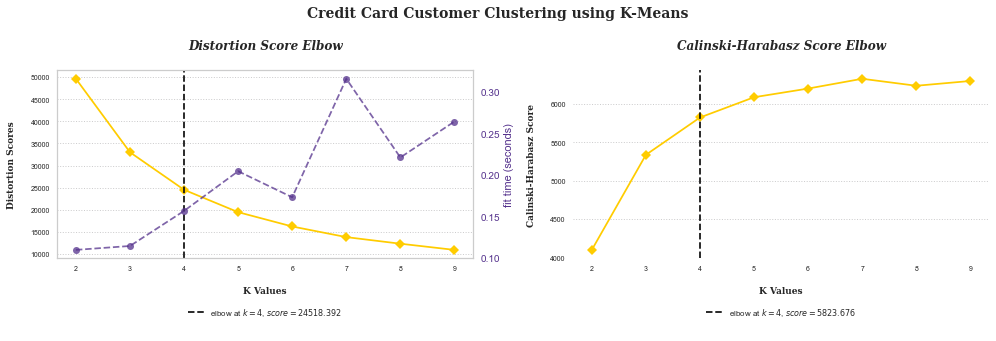

In [74]:
# --- Define K-Means Functions ---
def kmeans():
    
    # --- Figures Settings ---
    color_palette=['#FFCC00', '#54318C']
    set_palette(color_palette)
    title=dict(fontsize=12, fontweight='bold', style='italic', fontfamily='serif')
    text_style=dict(fontweight='bold', fontfamily='serif')
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
    
    # --- Elbow Score ---
    elbow_score = KElbowVisualizer(KMeans(random_state=32, max_iter=500), k=(2, 10), ax=ax1)
    elbow_score.fit(X)
    elbow_score.finalize()
    elbow_score.ax.set_title('Distortion Score Elbow\n', **title)
    elbow_score.ax.tick_params(labelsize=7)
    for text in elbow_score.ax.legend_.texts:
        text.set_fontsize(9)
    for spine in elbow_score.ax.spines.values():
        spine.set_color('None')
    elbow_score.ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), borderpad=2, frameon=False, fontsize=8)
    elbow_score.ax.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    elbow_score.ax.grid(axis='x', alpha=0)
    elbow_score.ax.set_xlabel('\nK Values', fontsize=9, **text_style)
    elbow_score.ax.set_ylabel('Distortion Scores\n', fontsize=9, **text_style)
    
    # --- Elbow Score (Calinski-Harabasz Index) ---
    elbow_score_ch = KElbowVisualizer(KMeans(random_state=32, max_iter=500), k=(2, 10), metric='calinski_harabasz', timings=False, ax=ax2)
    elbow_score_ch.fit(X)
    elbow_score_ch.finalize()
    elbow_score_ch.ax.set_title('Calinski-Harabasz Score Elbow\n', **title)
    elbow_score_ch.ax.tick_params(labelsize=7)
    for text in elbow_score_ch.ax.legend_.texts:
        text.set_fontsize(9)
    for spine in elbow_score_ch.ax.spines.values():
        spine.set_color('None')
    elbow_score_ch.ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), borderpad=2, frameon=False, fontsize=8)
    elbow_score_ch.ax.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    elbow_score_ch.ax.grid(axis='x', alpha=0)
    elbow_score_ch.ax.set_xlabel('\nK Values', fontsize=9, **text_style)
    elbow_score_ch.ax.set_ylabel('Calinski-Harabasz Score\n', fontsize=9, **text_style)
    
    plt.suptitle('Credit Card Customer Clustering using K-Means', fontsize=14, **text_style)
    plt.tight_layout()
    plt.show();

# --- Calling K-Means Functions ---
kmeans();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    Based on the results of the elbow method and Calinski Harabasz score above, it can be concluded that the <b>best clustering number</b> for the K-Means algorithm is <mark><b>4 clusters</b></mark>. The following steps will <mark><b>apply the number of optimal clusters, visualize clusters distribution plot, and silhouette plots to evaluate their performance</b></mark>.
</div>

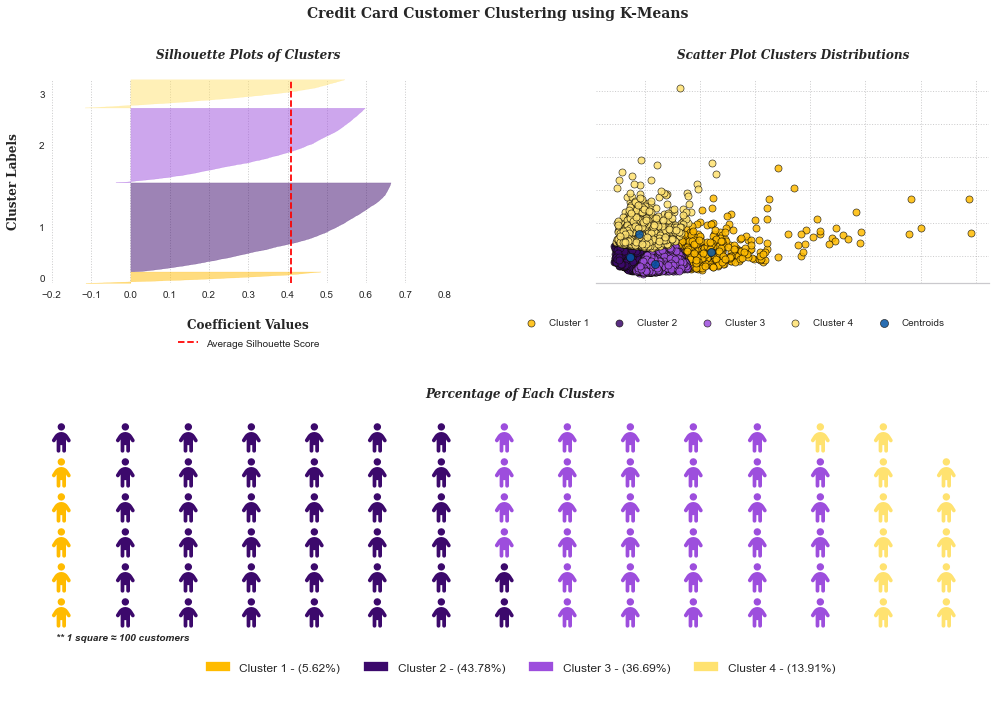

In [75]:
# --- Implementing K-Means ---
kmeans = KMeans(n_clusters=4, random_state=32, max_iter=500)
y_kmeans = kmeans.fit_predict(X)
    
# --- Define K-Means Visualizer & Plots ---
def visualizer(kmeans, y_kmeans):
    
    # --- Figures Settings ---
    cluster_colors=['#FFBB00', '#3C096C', '#9D4EDD', '#FFE270']
    labels = ['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Centroids']
    title=dict(fontsize=12, fontweight='bold', style='italic', fontfamily='serif')
    text_style=dict(fontweight='bold', fontfamily='serif')
    scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.85)
    legend_style=dict(borderpad=2, frameon=False, fontsize=10)
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(14, 10))
    
    # --- Silhouette Plots ---
    s_viz = SilhouetteVisualizer(kmeans, ax=ax1, colors=cluster_colors)
    s_viz.fit(X)
    s_viz.finalize()
    s_viz.ax.set_title('Silhouette Plots of Clusters\n', **title)
    s_viz.ax.tick_params(labelsize=10)
    for text in s_viz.ax.legend_.texts:
        text.set_fontsize(9)
    for spine in s_viz.ax.spines.values():
        spine.set_color('None')
    s_viz.ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), **legend_style)
    s_viz.ax.grid(axis='x', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    s_viz.ax.grid(axis='y', alpha=0)
    s_viz.ax.set_xlabel('\nCoefficient Values', fontsize=12, **text_style)
    s_viz.ax.set_ylabel('Cluster Labels\n', fontsize=12, **text_style)
        
    # --- Clusters Distribution ---
    y_kmeans_labels = list(set(y_kmeans.tolist()))
    for i in y_kmeans_labels:
        ax2.scatter(X[y_kmeans==i, 0], X[y_kmeans == i, 1], s=50, c=cluster_colors[i], **scatter_style)
    ax2.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=65, c='#0353A4', label='Centroids', **scatter_style)
    for spine in ax2.spines.values():
        spine.set_color('None')
    ax2.set_title('Scatter Plot Clusters Distributions\n', **title)
    ax2.legend(labels, bbox_to_anchor=(0.95, -0.05), ncol=5, **legend_style)
    ax2.grid(axis='both', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    ax2.tick_params(left=False, right=False , labelleft=False , labelbottom=False, bottom=False)
    ax2.spines['bottom'].set_visible(True)
    ax2.spines['bottom'].set_color('#CAC9CD')
    
    # --- Waffle Chart ---
    unique, counts = np.unique(y_kmeans, return_counts=True)
    df_waffle = dict(zip(unique, counts))
    total = sum(df_waffle.values())
    wfl_square = {key: value/100 for key, value in df_waffle.items()}
    wfl_label = {key: round(value/total*100, 2) for key, value in df_waffle.items()}

    ax3=plt.subplot(2, 2, (3,4))
    ax3.set_title('Percentage of Each Clusters\n', **title)
    ax3.set_aspect(aspect='auto')
    Waffle.make_waffle(ax=ax3, rows=6, values=wfl_square, colors=cluster_colors, 
                       labels=[f"Cluster {i+1} - ({k}%)" for i, k in wfl_label.items()], icons='child', icon_size=30, 
                       legend={'loc': 'upper center', 'bbox_to_anchor': (0.5, -0.05), 'ncol': 4, 'borderpad': 2, 
                               'frameon': False, 'fontsize':12})
    ax3.text(0.01, -0.09, '** 1 square ≈ 100 customers', weight = 'bold', style='italic', fontsize=10)
    
    # --- Suptitle & WM ---
    plt.suptitle('Credit Card Customer Clustering using K-Means\n', fontsize=14, **text_style)
    plt.tight_layout()
    plt.show();
    
# --- Calling K-Means Functions ---
visualizer(kmeans, y_kmeans);

### <div class="header2">Observations:-</div>
<div class="explain-box">
    The image above illustrates each cluster's silhouette coefficient values, each cluster distribution in the scatter plot, and each customer's number in a cluster. From the silhouette clusters, the silhouette value of each cluster is above the average, indicating <mark><b>all clusters are optimal</b></mark>. In addition, from the fluctuations of the silhouette plot size, <mark><b>all the clusters have a similar wide of fluctuations</b></mark>. However, from the thickness, <mark><b>clusters 2 and 3 have a thicker consistency than other clusters</b></mark>.<br><br>
    As mentioned before, compared to other clusters, clusters 2 and 3 have a higher viscosity. This is because <b>most data points are located at the bottom-left corner of the scatter plot</b>, and the number of customers in both clusters is <b>more than 35%</b>. In addition, the <mark><b>K-Means algorithm assumes that the data outliers are part of clusters 1 and 4</b></mark>, where the <b>outliers on the x-axis belong to cluster 1</b>, and the <b>outliers on the y-axis belong to cluster 4</b>. The waffle chart at the bottom of the visualisation shows the percentage distribution of customers in each group.<br><br>
    The next step is to <b>evaluate the clustering quality</b> provided by K-Means. Quality evaluation will use the <mark><b>Davies-Bouldin index, silhouette score, and Calinski-Harabasz index</b></mark>.<br>
    <blockquote style="font-size: 10px; color: #000000;">📌 <mark><b>Davis-Bouldin Index</b></mark> is a metric for evaluating clustering algorithms. It is defined as a <b>ratio between the cluster scatter and the cluster's separation</b>. Scores range from 0 and up. <mark><b>0 indicates better clustering</b></mark>.
    </blockquote>
    <blockquote style="font-size: 10px; color: #000000;">📌 <mark><b>Silhouette Coefficient/Score</b></mark> is a metric used to <b>calculate the goodness of a clustering technique</b>. Its value ranges from -1 to 1. <mark><b>The higher the score, the better</b></mark>. 1 means clusters are well apart from each other and clearly distinguished. 0 means clusters are indifferent/the distance between clusters is not significant. -1 means clusters are assigned in the wrong way.
    </blockquote>
    <blockquote style="font-size: 10px; color: #000000;">📌 <mark><b>Calinski-Harabasz Index</b></mark> (also known as the <b>Variance Ratio Criterion</b>), is the ratio of the sum of between-clusters dispersion and of inter-cluster dispersion for all clusters, <mark><b>the higher the score, the better the performances</b></mark>.
    </blockquote>
</div>

In [76]:
# --- Evaluate Clustering Quality Function ---
def evaluate_clustering(X, y):
    db_index = round(davies_bouldin_score(X, y), 3)
    s_score = round(silhouette_score(X, y), 3)
    ch_index = round(calinski_harabasz_score(X, y), 3)
    print('Evaluate Clustering Quality :')
    print('Davies-Bouldin Index: ', db_index)
    print('Silhouette Score: ', s_score)
    print('Calinski Harabasz Index: ', ch_index)
    return db_index, s_score, ch_index

# --- Evaluate K-Means Cluster Quality ---
db_kmeans, ss_kmeans, ch_kmeans = evaluate_clustering(X, y_kmeans)

Evaluate Clustering Quality :
Davies-Bouldin Index:  0.801
Silhouette Score:  0.408
Calinski Harabasz Index:  5823.676


### <div class="header2">Observations:-</div>
<div class="explain-box">
    Based on the evaluation score above, the <b>clustering quality</b> using K-Means with 4 clusters is <mark><b>decent</b></mark>. This is due to <mark><b>overlapping between clusters</b></mark>, as shown in the scatter plot in the previous section.
</div>

### <div class="header2">4.4.2 | DBSCAN</div>
<div class="explain-box">
    <blockquote style="color: #000000;">
        <mark><b>DBSCAN</b></mark> (Density-Based Spatial Clustering of Applications with Noise) groups points based on the <b>lowest number of points and the Euclidean distance</b>. It also <b>marks as outliers the points that are in low-density regions</b>. The two DBSCAN parameters are <mark><b>MinPoints and Epsilon</b></mark>.
<br>
    <center>
    <img src="https://www.researchgate.net/profile/David-Bonneau/publication/342082665/figure/fig2/AS:903773622898690@1592487831444/The-DBSCAN-algorithm-and-two-generated-clusters-There-are-three-types-of-points-as.png" alt="DBSCAN" width="35%"><br>
    <i style="font-size: 10px;">🖼 DBSCAN Clustering by David A. Bonneau</i>
    </center>
    </blockquote>
    Before applying the DBSCAN algorithm, we have to define DBSCAN parameters mentioned previously. For <mark><b>MinPoint</b></mark>, since PCA already performed into two dimensions, we will use <b>the default value (4)</b> as MinPoint values. For <mark><b>Epsilon values</b></mark>, using the Nearest Neighbors, we will determine the separation between each data point and its nearest neighbor, and then we sort them before plotting them. After that, we can <b>determine the greatest value</b> at the curve of the graph from the plot.
</div>


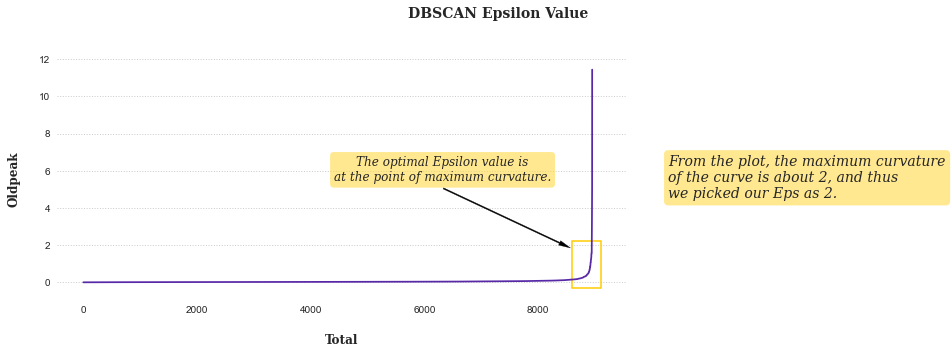

In [77]:
# --- Define Epsilon Values ---
def epsilon():
    
    # --- Calculate Nearest Neighbors ---
    neighbors=NearestNeighbors(n_neighbors=2)
    nbrs=neighbors.fit(X)
    distances, indices=nbrs.kneighbors(X)
    distances=np.sort(distances, axis = 0)
    
    # --- Figure Settings ---
    bbox=dict(boxstyle='round', pad=0.3, color='#FFDA47', alpha=0.6)
    txt1=dict(textcoords='offset points', va='center', ha='center', fontfamily='serif', style='italic')
    txt2=dict(textcoords='offset points', va='center', fontfamily='serif', style='italic')
    kw=dict(arrowstyle='Simple, tail_width=0.1, head_width=0.4, head_length=1', color='black')
    text_style=dict(fontweight='bold', fontfamily='serif')
    fig=plt.figure(figsize=(14, 5))
    
    # --- Epsilon Plot ---
    distances_1=distances[:, 1]
    ax1=fig.add_subplot(1, 3, (1, 2))
    plt.plot(distances_1, color='#5829A7')
    plt.xlabel('\nTotal', fontsize=12, **text_style)
    plt.ylabel('Oldpeak\n', fontsize=12, **text_style)
    ax1.add_patch(Rectangle((8600, -0.3), 500, 2.5, edgecolor='#FFCC00', fill=False, lw=1.5))
    plt.annotate('The optimal Epsilon value is\nat the point of maximum curvature.', xy=(6300, 6), xytext=(1, 1), fontsize=12, bbox=bbox, **txt1)
    plt.annotate('', xy=(8600, 1.8), xytext=(6300, 5.1), arrowprops=kw)
    for spine in ax1.spines.values():
        spine.set_color('None')
    plt.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    plt.grid(axis='x', alpha=0)
    plt.tick_params(labelsize=10)
    
    # --- Explanations ---
    ax2=fig.add_subplot(1, 3, 3)
    plt.annotate('From the plot, the maximum curvature\nof the curve is about 2, and thus\nwe picked our Eps as 2.', xy=(0.1, 0.5), xytext=(1, 1), fontsize=14, bbox=bbox, **txt2)
    for spine in ax2.spines.values():
        spine.set_color('None')
    plt.grid(axis='both', alpha=0)
    plt.axis('off')
    
    plt.suptitle('DBSCAN Epsilon Value\n', fontsize=14, **text_style)
    plt.tight_layout()
    plt.show();

# --- Calling Epsilon Functions ---
epsilon();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    Based on the results of the maximum curvature above and the previous MinPoint values, the next step is to <mark><b>implement DBSCAN and evaluate the results</b></mark>.
</div>

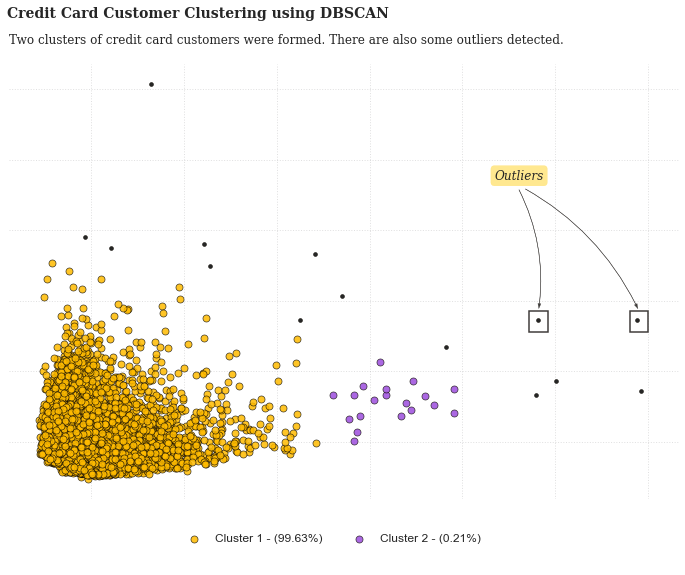

In [78]:
# --- Implementing DBSCAN ---
dbscan = DBSCAN(eps=2, min_samples=4)
y_dbscan = dbscan.fit_predict(X)
    
# --- Define DBSCAN Result Distribution ---
def dbscan_visualizer(dbscan, y_dbscan):
    
    # --- Figures Settings ---
    cluster_colors=['#FFBB00', '#9D4EDD', 'black']
    labels = ['Cluster 1', 'Cluster 2', 'Outliers']
    suptitle=dict(fontsize=14, fontweight='heavy', fontfamily='serif')
    title=dict(fontsize=12, fontfamily='serif')
    scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.85)
    bbox=dict(boxstyle='round', pad=0.3, color='#FFDA47', alpha=0.6)
    txt=dict(textcoords='offset points', va='center', ha='center', fontfamily='serif', style='italic')
    legend_style=dict(borderpad=2, frameon=False, fontsize=12)
    
    # --- Arrow Settings ---
    style = 'Simple, tail_width=0.3, head_width=3, head_length=5'
    kw = dict(arrowstyle=style, color='#3E3B39')
    arrow1 = patches.FancyArrowPatch((23, 18), (24.1, 9.3), connectionstyle='arc3, rad=-0.16', **kw)
    arrow2 = patches.FancyArrowPatch((23.3, 18), (29.5, 9.3), connectionstyle='arc3, rad=-0.16', **kw)
    
    # --- Percentage labels ---
    unique, counts = np.unique(y_dbscan, return_counts=True)
    dbscan_count = dict(zip(unique, counts))
    total = sum(dbscan_count.values())
    dbscan_label = {key: round(value/total*100, 2) for key, value in dbscan_count.items() if key != -1}

    # --- Clusters Distribution ---
    y_dbscan_labels = list(set(y_dbscan.tolist()))
    fig, ax = plt.subplots(1, 1, figsize=(12, 8))
    for i in np.arange(0, 2, 1):
        plt.scatter(X[y_dbscan==i, 0], X[y_dbscan == i, 1], s=50, c=cluster_colors[i], label=labels[i], **scatter_style)
    plt.scatter(X[y_dbscan==-1, 0], X[y_dbscan == -1, 1], s=15, c=cluster_colors[2], label=labels[2], **scatter_style)
    for spine in ax.spines.values():
        spine.set_color('None')
    plt.legend([f"Cluster {i+1} - ({k}%)" for i, k in dbscan_label.items()], bbox_to_anchor=(0.75, -0.01), ncol=3, **legend_style)
    plt.grid(axis='both', alpha=0.3, color='#9B9A9C', linestyle='dotted')
    ax.add_patch(Rectangle((29, 7.8), 1, 1.5, edgecolor='#3E3B39', fill=False, lw=1.5))
    ax.add_patch(Rectangle((23.6, 7.8), 1, 1.5, edgecolor='#3E3B39', fill=False, lw=1.5))
    ax.add_patch(arrow1)
    ax.add_patch(arrow2)
    plt.annotate('Outliers', xy=(23, 18.8), xytext=(1, 1), fontsize=12, bbox=bbox, **txt)
    plt.tick_params(left=False, right=False , labelleft=False , labelbottom=False, bottom=False)
    plt.title('Two clusters of credit card customers were formed. There are also some outliers detected.\n', loc='left', **title)
    plt.suptitle('Credit Card Customer Clustering using DBSCAN', x=0.123, y=0.98, ha='left', **suptitle)
    plt.show();
    
# --- Calling DBSCAN Functions ---
dbscan_visualizer(dbscan, y_dbscan);

### <div class="header2">Observations:-</div>
<div class="explain-box">
    From <b>DBSCAN</b> implementation, there are <mark><b>2 clusters formed</b></mark>. <b>Cluster 1 has the most data points</b> compared to cluster 2. However, <mark><b>there are some outliers detected</b></mark> since some points are too far from the other data points (DBSCAN considered it as an outlier and assigned -1 label to those points). The following step is to <b>assess the clustering quality</b> that DBSCAN provides.
</div>

In [79]:
# --- Evaluate DBSCAN Cluster Quality ---
db_dbscan, ss_dbscan, ch_dbscan = evaluate_clustering(X, y_dbscan)

Evaluate Clustering Quality :
Davies-Bouldin Index:  1.287
Silhouette Score:  0.803
Calinski Harabasz Index:  685.303


### <div class="header2">Observations:-</div>
<div class="explain-box">
    The <b>clustering quality</b> using DBSCAN with two clusters and outliers is <mark><b>fair</b></mark> according to the evaluation score above. The <b>silhouette score is better than K-Means</b> since there are one large cluster and one small cluster formed, although the <b>Davies-Bouldin index is higher than K-Means</b>, which indicates fair clustering. However, the <b>Calinski-Harabasz index obtained is much lower than K-Means</b>.
</div>

### <div class="header2">4.4.3 | Hierarchical Clustering (Agglomerative)</div>
<div class="explain-box">
    <blockquote style="color: #000000;">
        <mark><b>Hierarchical clustering</b></mark> works via <mark><b>grouping data</b></mark> into a <b>tree of clusters</b>. Hierarchical clustering begins by treating every data point as a separate cluster. Then, it repeatedly identify the 2 clusters which can be closest together, and merge the 2 maximum comparable clusters <b>until all the clusters are merged together</b>. In hierarchical clustering, the objective is to <mark><b>produce a hierarchical series of nested clusters</b></mark>. Dendrograms will be used to <b>visualize the history of groupings and figure out the optimal number of clusters</b>. Then using generated dendograms, we determine the largest vertical distance that doesn’t intersect any of the other clusters. Afther that, draw a threshold/horizontal line at both extremities. Finally, the optimal number of clusters is equal to the number of vertical lines going through the horizontal line. For eg., in the below case, best choice for no. of clusters will be 4.
<br>
    <center>
    <img src="https://miro.medium.com/max/1198/1*VvOVxdBb74IOxxF2RmthCQ.png" alt="Dendogram" width="35%"> <img src="https://miro.medium.com/max/1100/1*guOwD01bko5ITVIJWQdIPQ.png" alt="Clustering" width="23%"><br>
    <i style="font-size: 10px;">🖼 Dendogram and Hierarchical Clustering Result Example by Prasad Pai</i>
    </center>
    </blockquote>
    As a first step, we have to <mark><b>make a dendrogram first and then draw a horizontal line between both points</b></mark>. After that, we will <mark><b>evaluate the created dendrogram and compare it results with Calinski-Harabasz Score</b></mark>.
</div>

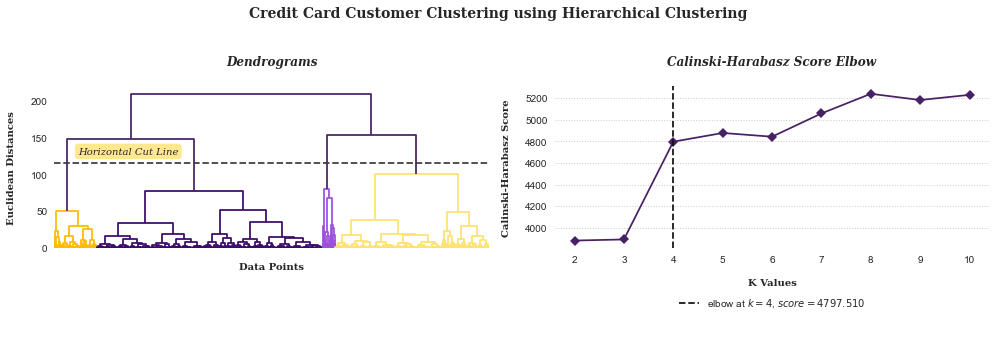

In [80]:
# --- Define Dendrogram ---
def agg_dendrogram():
    
    # --- Figure Settings ---
    color_palette=['#472165', '#FFBB00', '#3C096C', '#9D4EDD', '#FFE270']
    set_palette(color_palette)
    text_style=dict(fontweight='bold', fontfamily='serif')
    ann=dict(textcoords='offset points', va='center', ha='center', fontfamily='serif', style='italic')
    title=dict(fontsize=12, fontweight='bold', style='italic', fontfamily='serif')
    bbox=dict(boxstyle='round', pad=0.3, color='#FFDA47', alpha=0.6)
    fig=plt.figure(figsize=(14, 5))
    
    # --- Dendrogram Plot ---
    ax1=fig.add_subplot(1, 2, 1)
    dend=shc.dendrogram(shc.linkage(X, method='ward', metric='euclidean'))
    plt.axhline(y=115, color='#3E3B39', linestyle='--')
    plt.xlabel('\nData Points', fontsize=10, **text_style)
    plt.ylabel('Euclidean Distances\n', fontsize=10, **text_style)
    plt.annotate('Horizontal Cut Line', xy=(15000, 130), xytext=(1, 1), fontsize=10, bbox=bbox, **ann)
    plt.tick_params(labelbottom=False)
    for spine in ax1.spines.values():
        spine.set_color('None')
    plt.grid(axis='both', alpha=0)
    plt.tick_params(labelsize=10)
    plt.title('Dendrograms\n', **title)
    
    # --- Elbow Score (Calinski-Harabasz Index) ---
    ax2=fig.add_subplot(1, 2, 2)
    elbow_score_ch = KElbowVisualizer(AgglomerativeClustering(), metric='calinski_harabasz', timings=False, ax=ax2)
    elbow_score_ch.fit(X)
    elbow_score_ch.finalize()
    elbow_score_ch.ax.set_title('Calinski-Harabasz Score Elbow\n', **title)
    elbow_score_ch.ax.tick_params(labelsize=10)
    for text in elbow_score_ch.ax.legend_.texts:
        text.set_fontsize(10)
    for spine in elbow_score_ch.ax.spines.values():
        spine.set_color('None')
    elbow_score_ch.ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), borderpad=2, frameon=False, fontsize=10)
    elbow_score_ch.ax.grid(axis='y', alpha=0.5, color='#9B9A9C', linestyle='dotted')
    elbow_score_ch.ax.grid(axis='x', alpha=0)
    elbow_score_ch.ax.set_xlabel('\nK Values', fontsize=10, **text_style)
    elbow_score_ch.ax.set_ylabel('Calinski-Harabasz Score\n', fontsize=10, **text_style)
    
    plt.suptitle('Credit Card Customer Clustering using Hierarchical Clustering\n', fontsize=14, **text_style)
    plt.tight_layout()
    plt.show();

# --- Calling Dendrogram Functions ---
agg_dendrogram();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    Based on the euclidean distance in the dendrogram above, it can be concluded that <mark><b>the cluster number will be four</b></mark> since the tallest vertical line/largest distance is on the first line/branch (at the left of image) and the threshold cuts the dendrogram into four parts. In addition, based on the <b>Calinski-Harabasz score</b>, the optimal cluster obtained is 4.<br><br>
Next, we will <b>implement this number in the agglomerative clustering algorithm and visualize and evaluate the clusters created</b>.
</div>

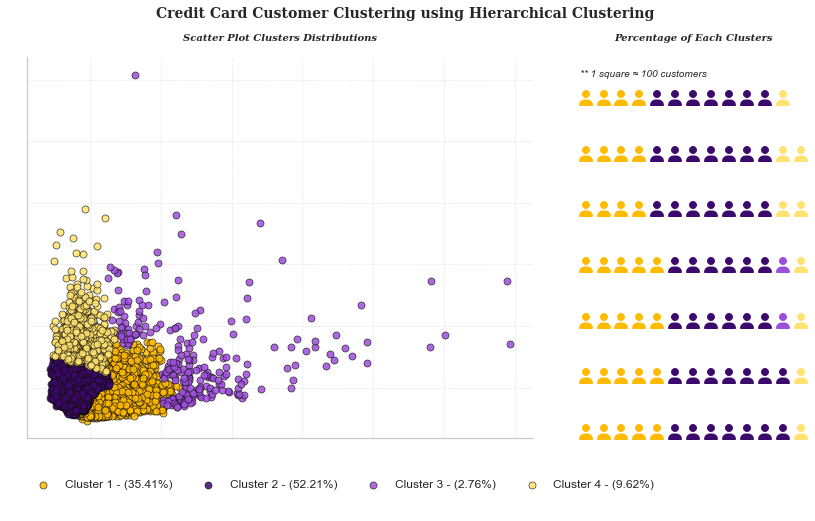

In [81]:
# --- Implementing Hierarchical Clustering ---
agg_cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')
y_agg_cluster = agg_cluster.fit_predict(X)
    
# --- Define Hierarchical Clustering Distributions ---
def agg_visualizer(agg_cluster, y_agg_cluster):
    
    # --- Figures Settings ---
    cluster_colors=['#FFBB00', '#3C096C', '#9D4EDD', '#FFE270']
    labels = ['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4']
    suptitle=dict(fontsize=14, fontweight='heavy', fontfamily='serif')
    title=dict(fontsize=10, fontweight='bold', style='italic', fontfamily='serif')
    scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.85)
    legend_style=dict(borderpad=2, frameon=False, fontsize=12)
    fig=plt.figure(figsize=(14, 7))
    
    # --- Percentage Labels ---
    unique, counts = np.unique(y_agg_cluster, return_counts=True)
    df_waffle = dict(zip(unique, counts))
    total = sum(df_waffle.values())
    wfl_square = {key: value/100 for key, value in df_waffle.items()}
    wfl_label = {key: round(value/total*100, 2) for key, value in df_waffle.items()}

    # --- Clusters Distribution ---
    y_agg_labels = list(set(y_agg_cluster.tolist()))
    ax1=fig.add_subplot(1, 3, (1, 2))
    for i in y_agg_labels:
        ax1.scatter(X[y_agg_cluster==i, 0], X[y_agg_cluster == i, 1], s=50, c=cluster_colors[i], label=labels[i], **scatter_style)
    for spine in ax1.spines.values():
        spine.set_color('None')
    for spine in ['bottom', 'left']:
        ax1.spines[spine].set_visible(True)
        ax1.spines[spine].set_color('#CAC9CD')
    ax1.legend([f"Cluster {i+1} - ({k}%)" for i, k in wfl_label.items()], bbox_to_anchor=(1.3, -0.03), ncol=4, **legend_style)
    ax1.grid(axis='both', alpha=0.3, color='#9B9A9C', linestyle='dotted')
    ax1.tick_params(left=False, right=False , labelleft=False , labelbottom=False, bottom=False)
    plt.title('Scatter Plot Clusters Distributions\n', **title)
    
    # --- Waffle Chart ---
    ax2=fig.add_subplot(1, 3, 3)
    ax2.set_title('Percentage of Each Clusters\n', **title)
    ax2.set_aspect(aspect='auto')
    Waffle.make_waffle(ax=ax2, rows=7, values=wfl_square, colors=cluster_colors, icons='user', icon_size=16)
    ax2.get_legend().remove()
    ax2.text(0.01, 0.95, '** 1 square ≈ 100 customers', style='italic', fontsize=10)
    
    plt.suptitle('Credit Card Customer Clustering using Hierarchical Clustering\n', **suptitle)
    plt.show();
    
# --- Calling Hierarchical Clustering Functions ---
agg_visualizer(agg_cluster, y_agg_cluster);

### <div class="header2">Observations:-</div>
<div class="explain-box">
    From hierarchical clustering implementation, it can be seen that there are <mark><b>4 clusters formed</b></mark>. From the 4 clusters, <b>cluster 2 has most data points</b>, followed by cluster 1. However, when compared with the results of clustering by K-Means, the results of cluster 2 using hierarchical have a <b>more significant percentage</b>. In addition, the hierarchical clustering algorithm considers <b>outliers to be part of cluster 3</b>.<br><br>
    The last step is to <mark><b>assess the clustering quality</b></mark> that hierarchical clustering offer. The <b>silhouette score</b> and <b>Davies-Bouldin index</b> will be used to evaluate quality.
</div>

In [82]:
# --- Evaluate DBSCAN Cluster Quality ---
db_agg, ss_agg, ch_agg = evaluate_clustering(X, y_agg_cluster)

Evaluate Clustering Quality :
Davies-Bouldin Index:  0.863
Silhouette Score:  0.388
Calinski Harabasz Index:  4797.51


### <div class="header2">Observations:-</div>
<div class="explain-box">
    Based on the results of evaluating the quality of clustering using hierarchical clustering, it can be seen that the results obtained are <b>slightly different from K-Means</b>. By using hierarchical clustering, the silhouette score obtained is close to 0, indicating <mark><b>overlapping clusters</b></mark>. In addition, a high Davies-Bouldin index indicates <mark><b>decent clustering quality</b></mark>. Compared to K-Means, the <b>silhouette score for hierarchical clustering is 0.06 higher</b>. And for the <b>Davies-Bouldin index</b>, the results obtained are <b>0.02 lower</b>. The <b>Calinski-Harabasz index obtained is slightly lower</b> compared to K-Means, but higher compared to DBSCAN.
</div>

### <div class="header2">4.5 | Models Evaluation</div>
<div class="explain-box">
    In this section, <mark><b>an evaluation of the quality of the clustering results</b></mark> from the algorithm that has been made will be carried out. This section will compare each clustering algorithm's clustering results (Davies-Bouldin index and silhouette score) in table format.
</div>

In [83]:
# --- Comparison Table ---
compare = pd.DataFrame({'Model': ['K-Means', 'DBSCAN', 'Hierarchical Clustering'], 
                        'Davies-Bouldin Index': [db_kmeans, db_dbscan, db_agg],
                        'Silhouette Score': [ss_kmeans, ss_dbscan, ss_agg],
                       'Calinski-Harabasz Index': [ch_kmeans, ch_dbscan, ch_agg]})

# --- Create Accuracy Comparison Table ---
print('Model Accuracy Comparison :')
compare.sort_values(by='Model', ascending=False).style.background_gradient(cmap='inferno_r').hide_index().set_properties(**{'font-family': 'Segoe UI'})

Model Accuracy Comparison :


Model,Davies-Bouldin Index,Silhouette Score,Calinski-Harabasz Index
K-Means,0.801000,0.408000,5823.676000
Hierarchical Clustering,0.863000,0.388000,4797.510000
DBSCAN,1.287000,0.803000,685.303000


### <div class="header2">Observations:-</div>
<div class="explain-box">
    The table above shows that the K-Means algorithm has the lowest Davies-Bouldin index compared to the other two algorithms, so it can be concluded that <b>K-Means has the decent clustering quality</b> compared to the other two algorithms. However, by silhouette score, <b>K-Means has the second highest silhouette score</b> (there are some overlapping clusters formed using this algorithm).<br><br>
    Furthermore, clustering using the <b>hierarchical clustering algorithm has similar clustering quality results as K-Means</b>. The Davies-Bouldin index is slightly higher, and the silhouette score is slightly lower than K-Means. Finally, clustering using <b>DBSCAN shows has the worst Davies-Bouldin index but the best silhouette score compared to other algorithms</b>.<br><br>
    From the results of the <b>Calinski-Harabasz index</b>, it can be seen that <b>K-Means has the highest index</b> compared to other algorithms. This indicates that <mark><b>K-Means performs better and is dense than other algorithms</b></mark>.<br><br>
It can be concluded that <mark><b>K-Means has the best clustering quality of the three algorithms</b></mark> due to the lowest Davies-Bouldin index value and slightly better overlapping clusters than hierarchical clustering. The next step is to do <mark><b>profiling</b></mark> to <b>identify each cluster characteristics</b>.
</div>

# <div class="header1">5. | Conclusions</div>

## <div class="header2">5.1 | Cluster Profiling</div>
<div class="explain-box">
    As mentioned in the previous section, this section will perform <mark><b>cluster profiling</b></mark> to <b>identify the characteristics of the clusters that have been created by K-Means</b>.
</div>

In [84]:
# --- Add K-Means Prediction to Data Frame ----
df['cluster_result'] = y_kmeans+1
df['cluster_result'] = 'Cluster '+df['cluster_result'].astype(str)

# --- Calculationg Overall Mean from Current Data Frame ---
df_profile_overall = pd.DataFrame()
df_profile_overall['Overall'] = df.describe().loc[['mean']].T

# --- Summarize Mean of Each Clusters --- 
df_cluster_summary = df.groupby('cluster_result').describe().T.reset_index().rename(columns={'level_0': 'Column Name', 'level_1': 'Metrics'})
df_cluster_summary = df_cluster_summary[df_cluster_summary['Metrics'] == 'mean'].set_index('Column Name')

# --- Combining Both Data Frame ---
print('Summarize of Each Clusters :')
df_profile = df_cluster_summary.join(df_profile_overall).reset_index()
df_profile.style.background_gradient(cmap='YlOrBr').hide_index()

Summarize of Each Clusters :


Column Name,Metrics,Cluster 1,Cluster 2,Cluster 3,Cluster 4,Overall
balance,mean,3401.840056,1012.915503,824.180354,4510.612798,1564.474828
balance_frequency,mean,0.988427,0.799792,0.919997,0.963486,0.877271
purchases,mean,6894.613917,223.081279,1236.499406,462.647357,1003.204834
oneoff_purchases,mean,4511.889901,157.576608,621.738764,300.127390,592.437371
installments_purchases,mean,2383.916859,65.833785,614.965725,162.619301,411.067645
cash_advance,mean,773.154467,614.588758,147.442197,4401.478579,978.871112
purchases_frequency,mean,0.954443,0.190099,0.862440,0.266258,0.490351
oneoff_purchases_frequency,mean,0.726667,0.074901,0.301883,0.129829,0.202458
purchases_installments_frequency,mean,0.808946,0.109962,0.675116,0.166187,0.364437
cash_advance_frequency,mean,0.084806,0.122459,0.030698,0.470904,0.135144


### <div class="header2">Observations:-</div>
<div class="explain-box">
    Based on the table above, it can be concluded that each cluster has the following <mark><b>characteristics</b></mark>:
    <blockquote style="color: #000000;">
        <ul>
            <li><mark style="font-weight: bold; background-color: #FFBB00">Cluster 1 (<u>Full Payers Users</u>)</mark>: Customers in this cluster are <mark style="font-weight: bold; background-color: #FFBB00"><b>active users of the bank's credit card</b></mark>. This can be seen from the frequency of the <b>balance which frequently changes</b> and the <b>balances amount is high enough</b> compared to other clusters. In addition, when compared to other clusters, <b>this cluster has higher mean value in several aspects</b> than other clusters. Credit card customers in this cluster also <b>actively use credit cards to facilitate transactions and installments</b>. <b>Cash advances, transactions, and installments in this cluster also occur more frequently</b>. The relatively <b>high tenure also shows that the credit scoring in this cluster is very good</b>.</li>
            <li><mark style="font-weight: bold; background-color: #3C096C; color: #FFFFFF;">Cluster 2 (<u>Starter/Student users</u>)</mark>: In contrast to cluster 1, <mark style="font-weight: bold; background-color: #3C096C; color: #FFFFFF;"><b>customers rarely/almost never use credit cards for transactions and installments</b></mark> in this cluster. This is because the customer <b>has a relatively small balance, the frequency of the balance rarely changes, and the installments are very low</b>. In addition, a <b>low credit limit</b> also shows that <b>customers rarely/almost never use credit cards to process credit transactions</b>, and customers in this cluster also <b>rarely make cash advances</b>. So, <mark style="font-weight: bold; background-color: #3C096C; color: #FFFFFF;"><b>it can be assumed that customers use credit cards for cash advance processes only with sufficient frequency</b></mark>. In addition, the low balance allows customers in this cluster <mark style="font-weight: bold; background-color: #3C096C; color: #FFFFFF;"><b>to be students or new users who use credit cards at this bank</b></mark>.</li>
            <li><mark style="font-weight: bold; background-color: #9D4EDD; color: #FFFFFF;">Cluster 3 (<u>Installment Users</u>)</mark>: In this cluster, customers use credit cards <mark style="font-weight: bold; background-color: #9D4EDD; color: #FFFFFF;"><b>specifically for installment purposes</b></mark>. This is due to the <b>relatively high level of transactions using installments in this cluster</b>. Moreover, customers in this cluster <b>often make transactions with very large amounts per transaction and the frequency and transactions of cash in advance are very small</b>. Customers in this cluster <b>very rarely make payments and cash in advance and have a relatively small cash-in-advance frequency and amount of payments</b>. It can be concluded that the <mark style="font-weight: bold; background-color: #9D4EDD; color: #FFFFFF;"><b>customers in this cluster are very suitable for credit cards specifically for installment needs</b></mark>.</li>
            <li><mark style="font-weight: bold; background-color: #FFE270">Cluster 4 (<u>Cash Advance/Withdraw Users</u>)</mark>: Customers in this cluster have <b>high balances, the balances frequency are always changing, and the frequency of cash in advance and cash in advance is high</b>. In addition, customers in this cluster have the <b>lowest interest rates compared to other clusters and have the second highest credit limit and payments</b> out of the four clusters. However, credit card users in this cluster <b>rarely make installments or one-off purchases and have the third-highest tenure</b> of the four clusters. Thus, it can be concluded that <mark style="font-weight: bold; background-color: #FFE270"><b>customers in this cluster only use credit cards for the need to withdraw money or cash advances</b></mark>.</li>
        </ul>
    </blockquote>
    The following are some <mark><b>visualizations</b></mark> of two variables in each cluster:
</div>

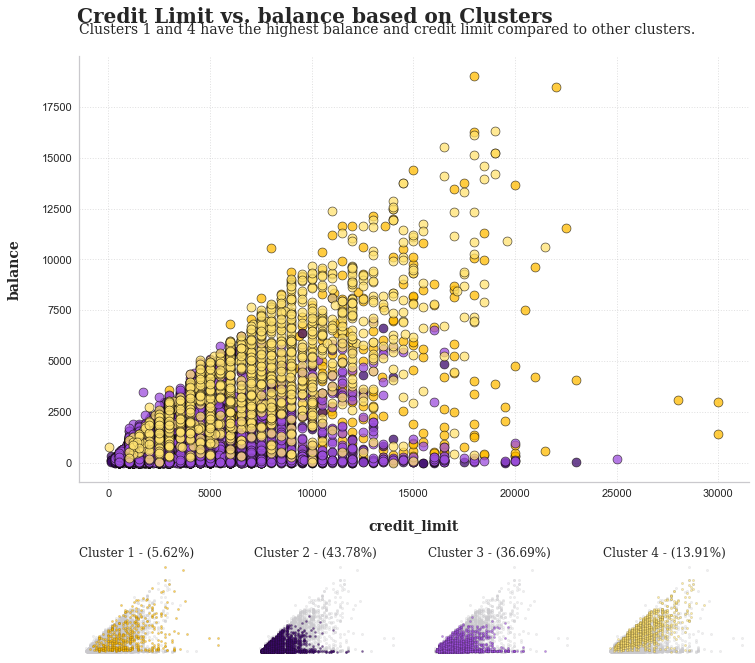

In [85]:
# --- Cluster Visualization 1: Variables ---
scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.75)
sub_scatter_style_color=dict(s=5, alpha=0.65, linewidth=0.15, zorder=10, edgecolor='#100C07')
sub_scatter_style_grey=dict(s=5, alpha=0.3, linewidth=0.7, zorder=5, color='#CAC9CD')
grid_style=dict(alpha=0.3, color='#9B9A9C', linestyle='dotted', zorder=1)
xy_label=dict(fontweight='bold', fontsize=14, fontfamily='serif')
suptitle=dict(fontsize=20, fontweight='heavy', fontfamily='serif')
title=dict(fontsize=14, fontfamily='serif')
color_pallete=['#FFBB00', '#3C096C', '#9D4EDD', '#FFE270']
sub_axes=[None] * 4

# --- Cluster Visualization 1: Data Frame ---
df_cv1 = df[['credit_limit', 'balance', 'cluster_result']]
cluster_result = sorted(df_cv1['cluster_result'].unique())

# --- Cluster Visualization 1: Settings ---
fig = plt.figure(figsize=(12, 16))
gs = fig.add_gridspec(4, 4)
ax = fig.add_subplot(gs[:4, :])
ax.set_aspect(1)

# --- Cluster Visualization 1: Main Scatter Plot ---
for x in range(len(cluster_result)):
    df_cv1_x = df_cv1[df_cv1['cluster_result']==cluster_result[x]]
    
    ax.scatter(df_cv1_x['credit_limit'], df_cv1_x['balance'], s=80, color=color_pallete[x], **scatter_style)
    ax.set_title('Clusters 1 and 4 have the highest balance and credit limit compared to other clusters.\n', loc='left', **title)
    ax.set_xlabel('\ncredit_limit', **xy_label)
    ax.set_ylabel('balance\n', **xy_label)
    ax.grid(axis='y', which='major', **grid_style)
    ax.grid(axis='x', which='major', **grid_style)
    for spine in ax.spines.values():
        spine.set_color('None')
    for spine in ['bottom', 'left']:
        ax.spines[spine].set_visible(True)
        ax.spines[spine].set_color('#CAC9CD')
    plt.xticks(fontsize=11)
    plt.yticks(fontsize=11)

# --- Cluster Visualization 1: Sub Plots ---
for idx, clstr in enumerate(cluster_result):
    sub_axes[idx] = fig.add_subplot(gs[3, idx], aspect=1)
    
    sub_axes[idx].scatter(df_cv1[df_cv1['cluster_result']!=clstr]['credit_limit'], df_cv1[df_cv1['cluster_result']!=clstr]['balance'], label=tnr, **sub_scatter_style_grey)
    sub_axes[idx].scatter(df_cv1[df_cv1['cluster_result']==clstr]['credit_limit'], df_cv1[df_cv1['cluster_result']==clstr]['balance'], color=color_pallete[idx], label=clstr, **sub_scatter_style_color)
    
    cnt = round((df_cv1['cluster_result']==clstr).sum()/8950*100, 2)
    sub_axes[idx].set_title(f'{clstr} - ({cnt}%)', loc='left', fontsize=12, fontfamily='serif')
    sub_axes[idx].set_xticks([])
    sub_axes[idx].set_yticks([])
    for spine in sub_axes[idx].spines.values():
        spine.set_color('None')

# --- Cluster Visualization 1: Title ---
plt.suptitle('Credit Limit vs. balance based on Clusters', x=0.123, y=0.73, ha='left', **suptitle)
plt.show();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    From the figure above, it can be seen that <b>clusters 1 and 4 have the highest balance and credit limit</b>. In addition, it can be seen that <mark><b>the more the balance increases, the more credit limits the customer gets</b></mark>. This can be seen clearly in clusters 1 and 4 because these clusters have customers who are <b>quite active in using credit cards</b>. However, this is different from <b>clusters 2 and 3</b>, where there is a <b>slight correlation</b> between the two variables because customers in this cluster have a <b>fairly rare frequency of balance updates</b>. In addition, it can be seen that <mark><b>the most zero balance card holders are in clusters 2 and 3</b></mark>.
</div>

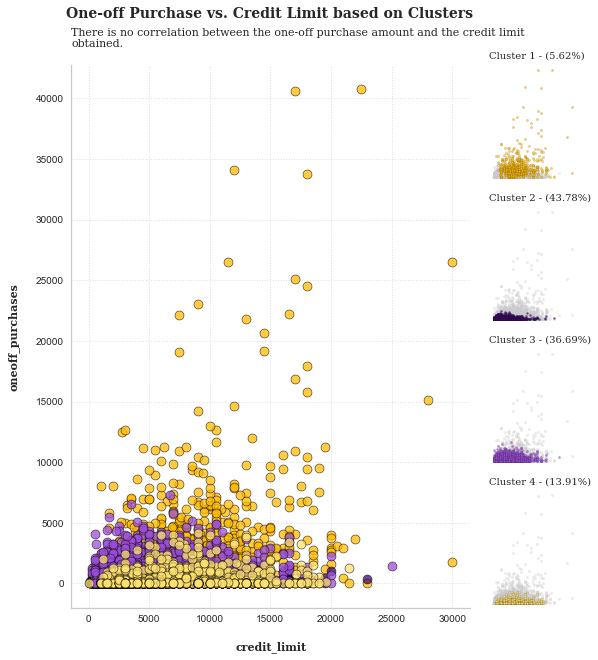

In [86]:
# --- Cluster Visualization 2: Variables ---
scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.75)
sub_scatter_style_color=dict(s=5, alpha=0.65, linewidth=0.15, zorder=10, edgecolor='#100C07')
sub_scatter_style_grey=dict(s=5, alpha=0.3, linewidth=0.7, zorder=5, color='#CAC9CD')
grid_style=dict(alpha=0.3, color='#9B9A9C', linestyle='dotted', zorder=1)
xy_label=dict(fontsize=11, fontweight='bold', fontfamily='serif')
suptitle=dict(fontsize=14, fontweight='heavy', fontfamily='serif')
title=dict(fontsize=11, fontfamily='serif')
color_pallete=['#FFBB00', '#3C096C', '#9D4EDD', '#FFE270']
sub_axes=[None] * 4

# --- Cluster Visualization 2: Data Frame ---
df_cv2 = df[['credit_limit', 'oneoff_purchases', 'cluster_result']]
cluster_result = sorted(df_cv1['cluster_result'].unique())

# --- Cluster Visualization 2: Settings ---
fig = plt.figure(figsize=(12, 10))
gs = fig.add_gridspec(4, 4)
ax = fig.add_subplot(gs[:4, :4])
ax.set_aspect(1)

# --- Cluster Visualization 2: Main Scatter Plot ---
for x in range(len(cluster_result)):
    df_cv2_x = df_cv2[df_cv2['cluster_result']==cluster_result[x]]
    
    ax.scatter(df_cv2_x['credit_limit'], df_cv2_x['oneoff_purchases'], s=80, color=color_pallete[x], **scatter_style)
    ax.set_title('There is no correlation between the one-off purchase amount and the credit limit\nobtained.\n', loc='left', **title)
    ax.set_xlabel('\ncredit_limit', **xy_label)
    ax.set_ylabel('oneoff_purchases\n', **xy_label)
    ax.grid(axis='y', which='major', **grid_style)
    ax.grid(axis='x', which='major', **grid_style)
    for spine in ax.spines.values():
        spine.set_color('None')
    for spine in ['bottom', 'left']:
        ax.spines[spine].set_visible(True)
        ax.spines[spine].set_color('#CAC9CD')
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)

# --- Cluster Visualization 2: Sub Plots ---
for idx, clstr in enumerate(cluster_result):
    sub_axes[idx] = fig.add_subplot(gs[idx, 3], aspect=1)
    
    sub_axes[idx].scatter(df_cv2[df_cv2['cluster_result']!=clstr]['credit_limit'], df_cv2[df_cv2['cluster_result']!=clstr]['oneoff_purchases'], label=tnr, **sub_scatter_style_grey)
    sub_axes[idx].scatter(df_cv2[df_cv2['cluster_result']==clstr]['credit_limit'], df_cv2[df_cv2['cluster_result']==clstr]['oneoff_purchases'], color=color_pallete[idx], label=clstr, **sub_scatter_style_color)
    
    cnt = round((df_cv2['cluster_result']==clstr).sum()/8950*100, 2)
    sub_axes[idx].set_title(f'{clstr} - ({cnt}%)', loc='left', fontsize=10, fontfamily='serif')
    sub_axes[idx].set_xticks([])
    sub_axes[idx].set_yticks([])
    for spine in sub_axes[idx].spines.values():
        spine.set_color('None')

# --- Cluster Visualization 2: Title ---
plt.suptitle('One-off Purchase vs. Credit Limit based on Clusters', x=0.275, y=0.96, ha='left', **suptitle)
plt.show();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    <mark><b>One-off purchase does not affect the additional credit limit obtained by the user</b></mark>. In the figure above and as mentioned earlier, it can be seen that <b>cluster 1 has a customer with the largest purchase amount for one transaction</b>.
</div>


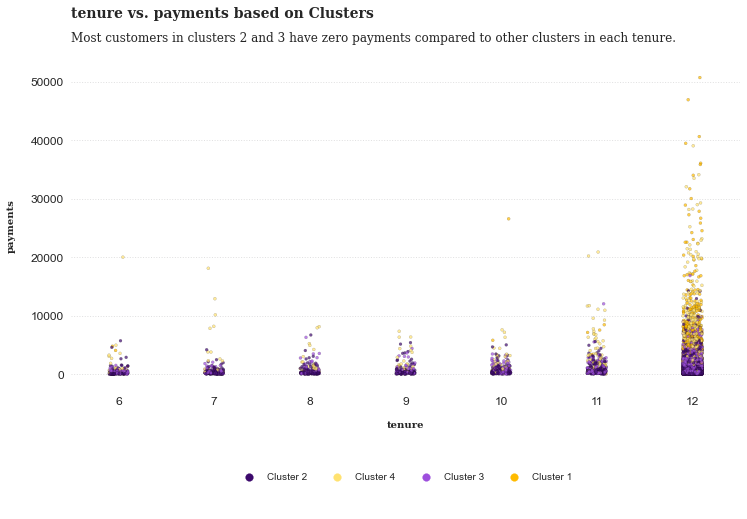

In [87]:
# --- Cluster Visualization 3: Data Frame ---
df_cv3 = df[['tenure', 'payments', 'cluster_result']]

# --- Cluster Visualization 3: Variables ---
color_pallete = ['#3C096C', '#FFE270', '#9D4EDD', '#FFBB00']
suptitle = dict(fontsize=14, ha='left', fontweight='heavy', fontfamily='serif')
title = dict(fontsize=12, loc='left', fontfamily='serif')
cluster_result = sorted(df_cv3['cluster_result'].unique())
stripplot_style = dict(edgecolor='#100C07', s=3, linewidth=0.15, alpha=0.7, palette=color_pallete)
legend_style = dict(ncol=5, borderpad=3, frameon=False, fontsize=10, title=None)
xy_label = dict(fontweight='bold', fontsize=10, fontfamily='serif')
grid_style = dict(alpha=0.3, color='#9B9A9C', linestyle='dotted', zorder=1)

# --- Cluster Visualization 3: Visuals ---
stplot=sns.stripplot(data=df_cv3, x='tenure', y='payments', hue='cluster_result', **stripplot_style)
sns.move_legend(stplot, 'upper center', bbox_to_anchor=(0.5, -0.15), **legend_style)
sns.despine(top=True, right=True, left=True, bottom=True)
plt.suptitle('tenure vs. payments based on Clusters', x=0.125, y=1.01, **suptitle)
plt.title('Most customers in clusters 2 and 3 have zero payments compared to other clusters in each tenure.\n', **title)
plt.xlabel('\ntenure', **xy_label)
plt.ylabel('payments\n', **xy_label)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='x', alpha=0)
plt.grid(axis='y', **grid_style)
plt.gcf().set_size_inches(12, 6)

plt.show();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    <mark><b>Most customers in clusters 2 and 3 have zero payments</b></mark> compared to other clusters in each tenure. As mentioned previously, it can be seen that <b>most customers tend to choose 12-month tenure</b>.
</div>


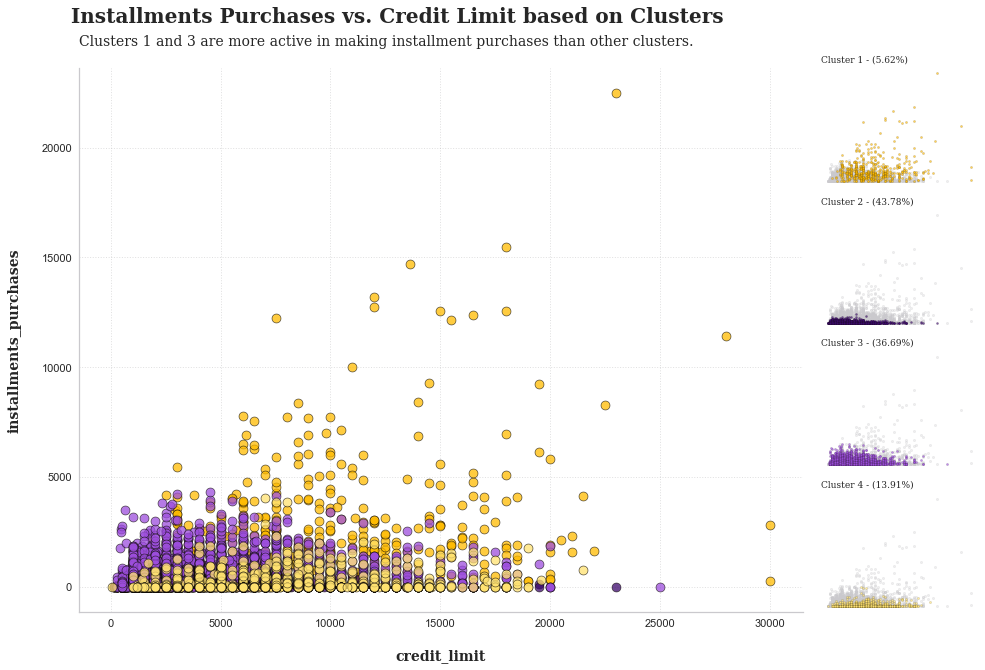

In [88]:
# --- Cluster Visualization 4: Data Frame ---
df_cv4 = df[['installments_purchases', 'credit_limit', 'cluster_result']]

# --- Cluster Visualization 4: Variables ---
cluster_result = sorted(df_cv4['cluster_result'].unique())
scatter_style=dict(linewidth=0.65, edgecolor='#100C07', alpha=0.75)
sub_scatter_style_color=dict(s=5, alpha=0.65, linewidth=0.15, zorder=10, edgecolor='#100C07')
sub_scatter_style_grey=dict(s=5, alpha=0.3, linewidth=0.7, zorder=5, color='#CAC9CD')
grid_style=dict(alpha=0.3, color='#9B9A9C', linestyle='dotted', zorder=1)
xy_label=dict(fontsize=14, fontweight='bold', fontfamily='serif')
suptitle=dict(fontsize=20, fontweight='heavy', fontfamily='serif')
title=dict(fontsize=14, fontfamily='serif')
xy_label=dict(fontweight='bold', fontsize=14, fontfamily='serif')
grid_style=dict(alpha=0.3, color='#9B9A9C', linestyle='dotted', zorder=1)
color_pallete=['#FFBB00', '#3C096C', '#9D4EDD', '#FFE270']
sub_axes=[None] * 4

# --- Cluster Visualization 4: Settings ---
fig = plt.figure(figsize=(21, 10))
gs = fig.add_gridspec(4, 4)
ax = fig.add_subplot(gs[:4, :4])
ax.set_aspect(1)

# --- Cluster Visualization 4: Main Scatter Plot ---
for x in range(len(cluster_result)):
    df_cv4_x = df_cv4[df_cv4['cluster_result']==cluster_result[x]]
    
    ax.scatter(df_cv4_x['credit_limit'], df_cv4_x['installments_purchases'], s=80, color=color_pallete[x], **scatter_style)
    ax.set_title('Clusters 1 and 3 are more active in making installment purchases than other clusters.\n', loc='left', **title)
    ax.set_xlabel('\ncredit_limit', **xy_label)
    ax.set_ylabel('installments_purchases\n', **xy_label)
    ax.grid(axis='y', which='major', **grid_style)
    ax.grid(axis='x', which='major', **grid_style)
    for spine in ax.spines.values():
        spine.set_color('None')
    for spine in ['bottom', 'left']:
        ax.spines[spine].set_visible(True)
        ax.spines[spine].set_color('#CAC9CD')
    plt.xticks(fontsize=11)
    plt.yticks(fontsize=11)
    
# --- Cluster Visualization 4: Sub Plots ---
for idx, clstr in enumerate(cluster_result):
    sub_axes[idx] = fig.add_subplot(gs[idx, 3], aspect=1)
    
    sub_axes[idx].scatter(df_cv4[df_cv4['cluster_result']!=clstr]['credit_limit'], df_cv4[df_cv4['cluster_result']!=clstr]['installments_purchases'], label=tnr, **sub_scatter_style_grey)
    sub_axes[idx].scatter(df_cv4[df_cv4['cluster_result']==clstr]['credit_limit'], df_cv4[df_cv4['cluster_result']==clstr]['installments_purchases'], color=color_pallete[idx], label=clstr, **sub_scatter_style_color)
    
    cnt = round((df_cv4['cluster_result']==clstr).sum()/8950*100, 2)
    sub_axes[idx].set_title(f'{clstr} - ({cnt}%)', loc='left', fontsize=9, fontfamily='serif')
    sub_axes[idx].set_xticks([])
    sub_axes[idx].set_yticks([])
    for spine in sub_axes[idx].spines.values():
        spine.set_color('None')

# --- Cluster Visualization 4: Title ---
plt.suptitle('Installments Purchases vs. Credit Limit based on Clusters', x=0.268, y=0.965, ha='left', **suptitle)
plt.show();

### <div class="header2">Observations:-</div>
<div class="explain-box">
    It can be seen that <mark><b>clusters 1 and 3 have more installment purchases than clusters 2 and 4</b></mark>. However, it can also be seen that <b>a large number of installment purchases are not correlated with the credit limit increase</b>.
</div>

## <div class="header2">5.2 | Marketing Strategy Suggestions</div>
<div class="explain-box">
    Based on the results of the profiling above, here are some <mark><b>suggestions for marketing strategies</b></mark>:
    <blockquote style="color: #000000;">
        <ul>
            <li>Customers in <mark style="font-weight: bold; background-color: #FFBB00">cluster 1 can become the main target for credit card marketing</mark>. This is because customers in this cluster are very active in using credit cards, and customers have the highest tenure and credit limits compared to other clusters. By focusing marketing on this cluster, <mark style="font-weight: bold; background-color: #FFBB00">banks can increase their profits by using more/frequent credit cards and streamlining marketing costs incurred</mark>. Banks can offer <b>benefits or rewards</b> for using credit cards to attract customers to use credit cards more often.</li>
            <li>For credit cards specifically for <mark style="font-weight: bold; background-color: #9D4EDD; color: #FFFFFF;">installments</mark>, banks can focus their marketing on customers in <mark style="font-weight: bold; background-color: #9D4EDD; color: #FFFFFF;">cluster 3</mark>. This is because customers in cluster 3 are more likely to make credit card transactions for installment purposes. <mark style="font-weight: bold; background-color: #9D4EDD; color: #FFFFFF;">Banks can offer installment programs that are low or 0% interest and can be used for various installment</mark> needs to customers in this cluster to attract customers to use credit cards. The installment requirements that can be offered can be in the form of <b>travelling payments, household appliances, electronic devices, smartphones, or certain brands that are most in demand by the public</b>.</li>
            <li>For <mark style="font-weight: bold; background-color: #3C096C; color: #FFFFFF;">cluster 2</mark>, banks can offer special credit cards for beginners or students <mark style="font-weight: bold; background-color: #3C096C; color: #FFFFFF;">(entry-level cards)</mark> who may <b>lack an extensive credit profile</b>. This credit card can be used to <b>build their credit and learn how to use the credit card responsibly</b>. This card can include <mark style="font-weight: bold; background-color: #3C096C; color: #FFFFFF;">several features</mark>, such as waived fees, rewards for setting a routine of timely payments, low barriers to becoming a cardholder and lenient interest rates. Also, banks can offer <b>opportunities to upgrade to new products and better terms and conditions</b> if the customer consistently pays the bills on time. In addition, banks can offer <b>sign-up rewards</b> so that customers who are not users of the bank's credit card can be interested in registering.</li>
            <li>Since customers in <mark style="font-weight: bold; background-color: #FFE270">cluster 4</mark> tend to make cash advances, banks can offer <mark style="font-weight: bold; background-color: #FFE270">special credit cards with various benefits</mark>. These benefits can be in the form of <b>low or no cash advance or admin fees, low interest, relatively high tenure, etc</b>. In addition, banks can also offer <mark style="font-weight: bold; background-color: #FFE270">bank programs other than credit cards</mark>, such as <b>pay-later programs with third-party collaborations or personal loans provided by banks</b>.</li>
        </ul>
    </blockquote>
</div>

<div class="explain-box">
    <center>
    <span class="thanks-watermark"><u>Follow me in other platform</u></span><br>
    <div align="center" class="social-media">
            <a href="https://public.tableau.com/app/profile/isabel.johnson001"><img src="https://i.imgur.com/JVxVkeQ.png" width="2%"></a><a href="https://github.com/isabeljohnson001/"><img src="https://i.imgur.com/Orp40Ys.png" width="2%"></a>
            <a href="https://www.linkedin.com/in/isabeljohnson06"><img src="https://i.imgur.com/vVYd0aI.png" width="2%"></a>
    </div>
        </center>
    </div>